In [0]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import col, when, lit, create_map, expr, avg, count
from pyspark.sql.types import DoubleType, IntegerType, StringType
from itertools import chain
import pandas as pd
from sklearn.impute import KNNImputer
import numpy as np

# Step 1: Load the dataset
music_df = (spark.read
      .format("csv")
      .option("header","true")
      .option("inferSchema", "true")
      .load("/FileStore/music/mxmh_survey_results.csv"))

# Step 2: Check for missing values
missing_counts = {col: music_df.filter(music_df[col].isNull() | (music_df[col] == "")).count() for col in music_df.columns}
print("Missing Counts:")
for col, count in missing_counts.items():
    print(f"{col}: {count}")

# Step 3: Register the DataFrame as a temporary view for SQL queries
music_df.createOrReplaceTempView("music_mental_health")

# Step 4: Convert to pandas for more flexible imputation
pandas_df = music_df.toPandas()

# Step 5: Create a copy for imputation
impute_df = pandas_df.copy()

# Step 6: Convert frequency columns to numeric values
frequency_mapping = {
    "Never": 0,
    "Rarely": 1,
    "Sometimes": 2,
    "Very frequently": 3
}

frequency_cols = [col for col in impute_df.columns if col.startswith("Frequency")]
for col_name in frequency_cols:
    impute_df[col_name] = impute_df[col_name].map(frequency_mapping)

# Step 7: Convert columns to numeric where possible
numeric_cols = ["Age", "Hours per day", "BPM", "Anxiety", "Depression", "Insomnia", "OCD"]
for col_name in numeric_cols:
    impute_df[col_name] = pd.to_numeric(impute_df[col_name], errors='coerce')

# Step 8: Separate numeric and categorical columns
categorical_cols = ["Primary streaming service", "While working", "Instrumentalist", 
                   "Composer", "Fav genre", "Exploratory", "Foreign languages", "Music effects"]

# Step 9: Impute numeric columns with KNN
# First, select only numeric columns that have missing values
numeric_cols_with_missing = [col for col in numeric_cols if impute_df[col].isna().any()]
# Add some frequency columns as features for better imputation
selected_features = numeric_cols_with_missing + [col for col in frequency_cols if not impute_df[col].isna().any()][:10]

# Create a subset with only selected features
impute_subset = impute_df[selected_features].copy()

# Initialize the KNN imputer
imputer = KNNImputer(n_neighbors=5, weights='distance')

# Perform imputation
imputed_data = imputer.fit_transform(impute_subset)

# Update the original dataframe with imputed values
imputed_subset = pd.DataFrame(imputed_data, columns=selected_features, index=impute_df.index)
for col in numeric_cols_with_missing:
    impute_df[col] = imputed_subset[col]

# Step 10: Impute categorical columns using mode by groups
# Create age groups for better grouping
impute_df['Age_Group'] = pd.cut(impute_df['Age'], 
                              bins=[0, 18, 25, 35, 50, 100], 
                              labels=['Under 18', '18-24', '25-34', '35-49', '50+'])

# Impute categorical columns
for col in categorical_cols:
    # Skip if no missing values
    if not impute_df[col].isna().any():
        continue
        
    # Get indices of missing values
    missing_indices = impute_df[col].isna()
    
    # If there are missing values in this column
    if missing_indices.any():
        # For each missing value
        for idx in impute_df[missing_indices].index:
            # Get the favorite genre and age group of this person
            fav_genre = impute_df.loc[idx, 'Fav genre']
            age_group = impute_df.loc[idx, 'Age_Group']
            
            # Find similar people based on genre and age group
            similar_people = impute_df[(impute_df['Fav genre'] == fav_genre) & 
                                     (impute_df['Age_Group'] == age_group) &
                                     (~impute_df[col].isna())]
            
            if len(similar_people) > 0:
                # Use the most common value from similar people
                most_common_value = similar_people[col].mode()[0]
                impute_df.loc[idx, col] = most_common_value
            else:
                # If no similar people found, use the overall mode
                most_common_value = impute_df[col].dropna().mode()[0]
                impute_df.loc[idx, col] = most_common_value

# Step 11: Special handling for 'Music effects' - impute based on mental health scores
missing_music_effects = impute_df['Music effects'].isna()
if missing_music_effects.any():
    for idx in impute_df[missing_music_effects].index:
        # Calculate mental health severity
        mental_health_sum = (
            float(impute_df.loc[idx, "Anxiety"] or 0) + 
            float(impute_df.loc[idx, "Depression"] or 0) + 
            float(impute_df.loc[idx, "Insomnia"] or 0) + 
            float(impute_df.loc[idx, "OCD"] or 0)
        )
        
        # Determine severity category
        if mental_health_sum > 20:
            severity = "High"
        elif mental_health_sum > 10:
            severity = "Medium"
        else:
            severity = "Low"
        
        # Determine listening intensity
        hours = float(impute_df.loc[idx, "Hours per day"] or 0)
        if hours > 4:
            intensity = "High"
        elif hours >= 2:
            intensity = "Medium"
        else:
            intensity = "Low"
        
        # Find similar profiles
        similar_profiles = impute_df[
            (~impute_df['Music effects'].isna()) & 
            ((impute_df['Anxiety'] + impute_df['Depression'] + 
              impute_df['Insomnia'] + impute_df['OCD'] > 20) if severity == "High" else True) &
            ((impute_df['Anxiety'] + impute_df['Depression'] + 
              impute_df['Insomnia'] + impute_df['OCD'] > 10) if severity == "Medium" else True) &
            ((impute_df['Hours per day'] > 4) if intensity == "High" else True) &
            ((impute_df['Hours per day'] >= 2) if intensity == "Medium" else True)
        ]
        
        if len(similar_profiles) > 0:
            # Use the most common music effect for similar profiles
            most_common_effect = similar_profiles['Music effects'].mode()[0]
            impute_df.loc[idx, 'Music effects'] = most_common_effect
        else:
            # Default to "Improve" as it's the most common
            impute_df.loc[idx, 'Music effects'] = "Improve"

# Step 12: Convert frequency columns back to categorical
for col_name in frequency_cols:
    reverse_mapping = {v: k for k, v in frequency_mapping.items()}
    impute_df[col_name] = impute_df[col_name].map(lambda x: reverse_mapping.get(x, "Never"))

# Step 13: Convert back to Spark DataFrame
clean_music_df = spark.createDataFrame(impute_df)

# Step 14: Create numeric versions of frequency columns
for col_name in frequency_cols:
    mapping_expr = create_map([lit(x) for x in chain(*frequency_mapping.items())])
    clean_music_df = clean_music_df.withColumn(col_name + "_numeric", mapping_expr[clean_music_df[col_name]])

# Step 15: Create numeric versions of mental health scores
from pyspark.sql.functions import col as column_function
for col_name in ["Anxiety", "Depression", "Insomnia", "OCD"]:
    clean_music_df = clean_music_df.withColumn(col_name + "_numeric", column_function(col_name).cast("double"))

# Step 16: Create a feature for music effect
clean_music_df = clean_music_df.withColumn("Music_Effect_Score", 
                  when(column_function("Music effects") == "Improve", 1)
                  .when(column_function("Music effects") == "No effect", 0)
                  .when(column_function("Music effects") == "Worsen", -1)
                  .otherwise(0))

# Step 17: Verify no missing values remain
missing_counts_after = {col: clean_music_df.filter(clean_music_df[col].isNull() | (clean_music_df[col] == "")).count() 
                        for col in clean_music_df.columns}

print("\nMissing Counts After Imputation:")
for col, count in missing_counts_after.items():
    if count > 0:
        print(f"{col}: {count}")
    
# If no columns are printed, all missing values have been successfully imputed

# Step 18: Register the clean DataFrame as a temporary view
clean_music_df.createOrReplaceTempView("clean_music_mental_health")

# Final output
print("\nData cleaning and imputation completed successfully!")
print(f"Original shape: {music_df.count()} rows, {len(music_df.columns)} columns")
print(f"Clean shape: {clean_music_df.count()} rows, {len(clean_music_df.columns)} columns")


Missing Counts:
Timestamp: 0
Age: 1
Primary streaming service: 1
Hours per day: 0
While working: 3
Instrumentalist: 4
Composer: 1
Fav genre: 0
Exploratory: 0
Foreign languages: 4
BPM: 107
Frequency [Classical]: 0
Frequency [Country]: 0
Frequency [EDM]: 0
Frequency [Folk]: 0
Frequency [Gospel]: 0
Frequency [Hip hop]: 0
Frequency [Jazz]: 0
Frequency [K pop]: 0
Frequency [Latin]: 0
Frequency [Lofi]: 0
Frequency [Metal]: 0
Frequency [Pop]: 0
Frequency [R&B]: 0
Frequency [Rap]: 0
Frequency [Rock]: 0
Frequency [Video game music]: 0
Anxiety: 0
Depression: 0
Insomnia: 0
OCD: 0
Music effects: 8

Missing Counts After Imputation:

Data cleaning and imputation completed successfully!
Original shape: 736 rows, 32 columns
Clean shape: 736 rows, 54 columns


In [0]:
clean_music_df.display()

Timestamp,Age,Primary streaming service,Hours per day,While working,Instrumentalist,Composer,Fav genre,Exploratory,Foreign languages,BPM,Frequency [Classical],Frequency [Country],Frequency [EDM],Frequency [Folk],Frequency [Gospel],Frequency [Hip hop],Frequency [Jazz],Frequency [K pop],Frequency [Latin],Frequency [Lofi],Frequency [Metal],Frequency [Pop],Frequency [R&B],Frequency [Rap],Frequency [Rock],Frequency [Video game music],Anxiety,Depression,Insomnia,OCD,Music effects,Age_Group,Frequency [Classical]_numeric,Frequency [Country]_numeric,Frequency [EDM]_numeric,Frequency [Folk]_numeric,Frequency [Gospel]_numeric,Frequency [Hip hop]_numeric,Frequency [Jazz]_numeric,Frequency [K pop]_numeric,Frequency [Latin]_numeric,Frequency [Lofi]_numeric,Frequency [Metal]_numeric,Frequency [Pop]_numeric,Frequency [R&B]_numeric,Frequency [Rap]_numeric,Frequency [Rock]_numeric,Frequency [Video game music]_numeric,Anxiety_numeric,Depression_numeric,Insomnia_numeric,OCD_numeric,Music_Effect_Score
8/27/2022 19:29,18.0,Spotify,3.0,Yes,Yes,Yes,Latin,Yes,Yes,156.0,Rarely,Never,Rarely,Never,Never,Sometimes,Never,Very frequently,Very frequently,Rarely,Never,Very frequently,Sometimes,Very frequently,Never,Sometimes,3.0,0.0,1.0,0.0,Improve,Under 18,1,0,1,0,0,2,0,3,3,1,0,3,2,3,0,2,3.0,0.0,1.0,0.0,1
8/27/2022 19:57,63.0,Pandora,1.5,Yes,No,No,Rock,Yes,No,119.0,Sometimes,Never,Never,Rarely,Sometimes,Rarely,Very frequently,Rarely,Sometimes,Rarely,Never,Sometimes,Sometimes,Rarely,Very frequently,Rarely,7.0,2.0,2.0,1.0,Improve,50+,2,0,0,1,2,1,3,1,2,1,0,2,2,1,3,1,7.0,2.0,2.0,1.0,1
8/27/2022 21:28,18.0,Spotify,4.0,No,No,No,Video game music,No,Yes,132.0,Never,Never,Very frequently,Never,Never,Rarely,Rarely,Very frequently,Never,Sometimes,Sometimes,Rarely,Never,Rarely,Rarely,Very frequently,7.0,7.0,10.0,2.0,No effect,Under 18,0,0,3,0,0,1,1,3,0,2,2,1,0,1,1,3,7.0,7.0,10.0,2.0,0
8/27/2022 21:40,61.0,YouTube Music,2.5,Yes,No,Yes,Jazz,Yes,Yes,84.0,Sometimes,Never,Never,Rarely,Sometimes,Never,Very frequently,Sometimes,Very frequently,Sometimes,Never,Sometimes,Sometimes,Never,Never,Never,9.0,7.0,3.0,3.0,Improve,50+,2,0,0,1,2,0,3,2,3,2,0,2,2,0,0,0,9.0,7.0,3.0,3.0,1
8/27/2022 21:54,18.0,Spotify,4.0,Yes,No,No,R&B,Yes,No,107.0,Never,Never,Rarely,Never,Rarely,Very frequently,Never,Very frequently,Sometimes,Sometimes,Never,Sometimes,Very frequently,Very frequently,Never,Rarely,7.0,2.0,5.0,9.0,Improve,Under 18,0,0,1,0,1,3,0,3,2,2,0,2,3,3,0,1,7.0,2.0,5.0,9.0,1
8/27/2022 21:56,18.0,Spotify,5.0,Yes,Yes,Yes,Jazz,Yes,Yes,86.0,Rarely,Sometimes,Never,Never,Never,Sometimes,Very frequently,Very frequently,Rarely,Very frequently,Rarely,Very frequently,Very frequently,Very frequently,Very frequently,Never,8.0,8.0,7.0,7.0,Improve,Under 18,1,2,0,0,0,2,3,3,1,3,1,3,3,3,3,0,8.0,8.0,7.0,7.0,1
8/27/2022 22:00,18.0,YouTube Music,3.0,Yes,Yes,No,Video game music,Yes,Yes,66.0,Sometimes,Never,Rarely,Sometimes,Rarely,Rarely,Sometimes,Never,Rarely,Rarely,Rarely,Rarely,Rarely,Never,Never,Sometimes,4.0,8.0,6.0,0.0,Improve,Under 18,2,0,1,2,1,1,2,0,1,1,1,1,1,0,0,2,4.0,8.0,6.0,0.0,1
8/27/2022 22:18,21.0,Spotify,1.0,Yes,No,No,K pop,Yes,Yes,95.0,Never,Never,Rarely,Never,Never,Very frequently,Rarely,Very frequently,Never,Sometimes,Never,Sometimes,Sometimes,Rarely,Never,Rarely,5.0,3.0,5.0,3.0,Improve,18-24,0,0,1,0,0,3,1,3,0,2,0,2,2,1,0,1,5.0,3.0,5.0,3.0,1
8/27/2022 22:33,19.0,Spotify,6.0,Yes,No,No,Rock,No,No,94.0,Never,Very frequently,Never,Sometimes,Never,Never,Never,Never,Never,Never,Very frequently,Never,Never,Never,Very frequently,Never,2.0,0.0,0.0,0.0,Improve,18-24,0,3,0,2,0,0,0,0,0,0,3,0,0,0,3,0,2.0,0.0,0.0,0.0,1
8/27/2022 22:44,18.0,I do not use a streaming service.,1.0,Yes,No,No,R&B,Yes,Yes,155.0,Rarely,Rarely,Rarely,Rarely,Sometimes,Rarely,Rarely,Never,Rarely,Rarely,Never,Sometimes,Sometimes,Rarely,Sometimes,Sometimes,2.0,2.0,5.0,1.0,Improve,Under 18,1,1,1,1,2,1,1,0,1,1,0,2,2,1,2,2,2.0,2.0,5.0,1.0,1


In [0]:
music_df.display()

Timestamp,Age,Primary streaming service,Hours per day,While working,Instrumentalist,Composer,Fav genre,Exploratory,Foreign languages,BPM,Frequency [Classical],Frequency [Country],Frequency [EDM],Frequency [Folk],Frequency [Gospel],Frequency [Hip hop],Frequency [Jazz],Frequency [K pop],Frequency [Latin],Frequency [Lofi],Frequency [Metal],Frequency [Pop],Frequency [R&B],Frequency [Rap],Frequency [Rock],Frequency [Video game music],Anxiety,Depression,Insomnia,OCD,Music effects
8/27/2022 19:29,18,Spotify,3.0,Yes,Yes,Yes,Latin,Yes,Yes,156,Rarely,Never,Rarely,Never,Never,Sometimes,Never,Very frequently,Very frequently,Rarely,Never,Very frequently,Sometimes,Very frequently,Never,Sometimes,3.0,0.0,1.0,0.0,null
8/27/2022 19:57,63,Pandora,1.5,Yes,No,No,Rock,Yes,No,119,Sometimes,Never,Never,Rarely,Sometimes,Rarely,Very frequently,Rarely,Sometimes,Rarely,Never,Sometimes,Sometimes,Rarely,Very frequently,Rarely,7.0,2.0,2.0,1.0,null
8/27/2022 21:28,18,Spotify,4.0,No,No,No,Video game music,No,Yes,132,Never,Never,Very frequently,Never,Never,Rarely,Rarely,Very frequently,Never,Sometimes,Sometimes,Rarely,Never,Rarely,Rarely,Very frequently,7.0,7.0,10.0,2.0,No effect
8/27/2022 21:40,61,YouTube Music,2.5,Yes,No,Yes,Jazz,Yes,Yes,84,Sometimes,Never,Never,Rarely,Sometimes,Never,Very frequently,Sometimes,Very frequently,Sometimes,Never,Sometimes,Sometimes,Never,Never,Never,9.0,7.0,3.0,3.0,Improve
8/27/2022 21:54,18,Spotify,4.0,Yes,No,No,R&B,Yes,No,107,Never,Never,Rarely,Never,Rarely,Very frequently,Never,Very frequently,Sometimes,Sometimes,Never,Sometimes,Very frequently,Very frequently,Never,Rarely,7.0,2.0,5.0,9.0,Improve
8/27/2022 21:56,18,Spotify,5.0,Yes,Yes,Yes,Jazz,Yes,Yes,86,Rarely,Sometimes,Never,Never,Never,Sometimes,Very frequently,Very frequently,Rarely,Very frequently,Rarely,Very frequently,Very frequently,Very frequently,Very frequently,Never,8.0,8.0,7.0,7.0,Improve
8/27/2022 22:00,18,YouTube Music,3.0,Yes,Yes,No,Video game music,Yes,Yes,66,Sometimes,Never,Rarely,Sometimes,Rarely,Rarely,Sometimes,Never,Rarely,Rarely,Rarely,Rarely,Rarely,Never,Never,Sometimes,4.0,8.0,6.0,0.0,Improve
8/27/2022 22:18,21,Spotify,1.0,Yes,No,No,K pop,Yes,Yes,95,Never,Never,Rarely,Never,Never,Very frequently,Rarely,Very frequently,Never,Sometimes,Never,Sometimes,Sometimes,Rarely,Never,Rarely,5.0,3.0,5.0,3.0,Improve
8/27/2022 22:33,19,Spotify,6.0,Yes,No,No,Rock,No,No,94,Never,Very frequently,Never,Sometimes,Never,Never,Never,Never,Never,Never,Very frequently,Never,Never,Never,Very frequently,Never,2.0,0.0,0.0,0.0,Improve
8/27/2022 22:44,18,I do not use a streaming service.,1.0,Yes,No,No,R&B,Yes,Yes,155,Rarely,Rarely,Rarely,Rarely,Sometimes,Rarely,Rarely,Never,Rarely,Rarely,Never,Sometimes,Sometimes,Rarely,Sometimes,Sometimes,2.0,2.0,5.0,1.0,Improve


In [0]:
from pyspark.sql import functions as F
# Filter out extreme values
clean_music_df = clean_music_df.filter(
    (F.col("Hours per day").isNull()) | 
    ((F.col("Hours per day") >= 0) & 
     (F.col("Hours per day") <= 18))
).filter(
    (F.col("BPM").isNull()) | 
    ((F.col("BPM") >= 40) & 
     (F.col("BPM") <= 300))
)

In [0]:
music_df = clean_music_df

In [0]:
music_df.display()

Timestamp,Age,Primary streaming service,Hours per day,While working,Instrumentalist,Composer,Fav genre,Exploratory,Foreign languages,BPM,Frequency [Classical],Frequency [Country],Frequency [EDM],Frequency [Folk],Frequency [Gospel],Frequency [Hip hop],Frequency [Jazz],Frequency [K pop],Frequency [Latin],Frequency [Lofi],Frequency [Metal],Frequency [Pop],Frequency [R&B],Frequency [Rap],Frequency [Rock],Frequency [Video game music],Anxiety,Depression,Insomnia,OCD,Music effects,Age_Group,Frequency [Classical]_numeric,Frequency [Country]_numeric,Frequency [EDM]_numeric,Frequency [Folk]_numeric,Frequency [Gospel]_numeric,Frequency [Hip hop]_numeric,Frequency [Jazz]_numeric,Frequency [K pop]_numeric,Frequency [Latin]_numeric,Frequency [Lofi]_numeric,Frequency [Metal]_numeric,Frequency [Pop]_numeric,Frequency [R&B]_numeric,Frequency [Rap]_numeric,Frequency [Rock]_numeric,Frequency [Video game music]_numeric,Anxiety_numeric,Depression_numeric,Insomnia_numeric,OCD_numeric,Music_Effect_Score
8/27/2022 19:29,18.0,Spotify,3.0,Yes,Yes,Yes,Latin,Yes,Yes,156.0,Rarely,Never,Rarely,Never,Never,Sometimes,Never,Very frequently,Very frequently,Rarely,Never,Very frequently,Sometimes,Very frequently,Never,Sometimes,3.0,0.0,1.0,0.0,Improve,Under 18,1,0,1,0,0,2,0,3,3,1,0,3,2,3,0,2,3.0,0.0,1.0,0.0,1
8/27/2022 19:57,63.0,Pandora,1.5,Yes,No,No,Rock,Yes,No,119.0,Sometimes,Never,Never,Rarely,Sometimes,Rarely,Very frequently,Rarely,Sometimes,Rarely,Never,Sometimes,Sometimes,Rarely,Very frequently,Rarely,7.0,2.0,2.0,1.0,Improve,50+,2,0,0,1,2,1,3,1,2,1,0,2,2,1,3,1,7.0,2.0,2.0,1.0,1
8/27/2022 21:28,18.0,Spotify,4.0,No,No,No,Video game music,No,Yes,132.0,Never,Never,Very frequently,Never,Never,Rarely,Rarely,Very frequently,Never,Sometimes,Sometimes,Rarely,Never,Rarely,Rarely,Very frequently,7.0,7.0,10.0,2.0,No effect,Under 18,0,0,3,0,0,1,1,3,0,2,2,1,0,1,1,3,7.0,7.0,10.0,2.0,0
8/27/2022 21:40,61.0,YouTube Music,2.5,Yes,No,Yes,Jazz,Yes,Yes,84.0,Sometimes,Never,Never,Rarely,Sometimes,Never,Very frequently,Sometimes,Very frequently,Sometimes,Never,Sometimes,Sometimes,Never,Never,Never,9.0,7.0,3.0,3.0,Improve,50+,2,0,0,1,2,0,3,2,3,2,0,2,2,0,0,0,9.0,7.0,3.0,3.0,1
8/27/2022 21:54,18.0,Spotify,4.0,Yes,No,No,R&B,Yes,No,107.0,Never,Never,Rarely,Never,Rarely,Very frequently,Never,Very frequently,Sometimes,Sometimes,Never,Sometimes,Very frequently,Very frequently,Never,Rarely,7.0,2.0,5.0,9.0,Improve,Under 18,0,0,1,0,1,3,0,3,2,2,0,2,3,3,0,1,7.0,2.0,5.0,9.0,1
8/27/2022 21:56,18.0,Spotify,5.0,Yes,Yes,Yes,Jazz,Yes,Yes,86.0,Rarely,Sometimes,Never,Never,Never,Sometimes,Very frequently,Very frequently,Rarely,Very frequently,Rarely,Very frequently,Very frequently,Very frequently,Very frequently,Never,8.0,8.0,7.0,7.0,Improve,Under 18,1,2,0,0,0,2,3,3,1,3,1,3,3,3,3,0,8.0,8.0,7.0,7.0,1
8/27/2022 22:00,18.0,YouTube Music,3.0,Yes,Yes,No,Video game music,Yes,Yes,66.0,Sometimes,Never,Rarely,Sometimes,Rarely,Rarely,Sometimes,Never,Rarely,Rarely,Rarely,Rarely,Rarely,Never,Never,Sometimes,4.0,8.0,6.0,0.0,Improve,Under 18,2,0,1,2,1,1,2,0,1,1,1,1,1,0,0,2,4.0,8.0,6.0,0.0,1
8/27/2022 22:18,21.0,Spotify,1.0,Yes,No,No,K pop,Yes,Yes,95.0,Never,Never,Rarely,Never,Never,Very frequently,Rarely,Very frequently,Never,Sometimes,Never,Sometimes,Sometimes,Rarely,Never,Rarely,5.0,3.0,5.0,3.0,Improve,18-24,0,0,1,0,0,3,1,3,0,2,0,2,2,1,0,1,5.0,3.0,5.0,3.0,1
8/27/2022 22:33,19.0,Spotify,6.0,Yes,No,No,Rock,No,No,94.0,Never,Very frequently,Never,Sometimes,Never,Never,Never,Never,Never,Never,Very frequently,Never,Never,Never,Very frequently,Never,2.0,0.0,0.0,0.0,Improve,18-24,0,3,0,2,0,0,0,0,0,0,3,0,0,0,3,0,2.0,0.0,0.0,0.0,1
8/27/2022 22:44,18.0,I do not use a streaming service.,1.0,Yes,No,No,R&B,Yes,Yes,155.0,Rarely,Rarely,Rarely,Rarely,Sometimes,Rarely,Rarely,Never,Rarely,Rarely,Never,Sometimes,Sometimes,Rarely,Sometimes,Sometimes,2.0,2.0,5.0,1.0,Improve,Under 18,1,1,1,1,2,1,1,0,1,1,0,2,2,1,2,2,2.0,2.0,5.0,1.0,1


### Feature Engineering

In [0]:
from pyspark.ml.feature import StringIndexer, OneHotEncoder
from pyspark.sql.functions import col, when, lit, array_max, array_min, array

7. Create features for genre diversity (number of genres listened to frequently)

In [0]:
music_df.createOrReplaceTempView("music_mental_health")

In [0]:
genre_diversity_df = spark.table("music_mental_health").withColumn(
    "Genre_Diversity",
    (col("Frequency [Classical]_numeric") >= 2).cast("int") +
    (col("Frequency [Country]_numeric") >= 2).cast("int") +
    (col("Frequency [EDM]_numeric") >= 2).cast("int") +
    (col("Frequency [Folk]_numeric") >= 2).cast("int") +
    (col("Frequency [Gospel]_numeric") >= 2).cast("int") +
    (col("Frequency [Hip hop]_numeric") >= 2).cast("int") +
    (col("Frequency [Jazz]_numeric") >= 2).cast("int") +
    (col("Frequency [K pop]_numeric") >= 2).cast("int") +
    (col("Frequency [Latin]_numeric") >= 2).cast("int") +
    (col("Frequency [Lofi]_numeric") >= 2).cast("int") +
    (col("Frequency [Metal]_numeric") >= 2).cast("int") +
    (col("Frequency [Pop]_numeric") >= 2).cast("int") +
    (col("Frequency [R&B]_numeric") >= 2).cast("int") +
    (col("Frequency [Rap]_numeric") >= 2).cast("int") +
    (col("Frequency [Rock]_numeric") >= 2).cast("int") +
    (col("Frequency [Video game music]_numeric") >= 2).cast("int")
)

In [0]:
music_df = genre_diversity_df.withColumn("Mental_Health_Severity",
col("Anxiety_numeric") + col("Depression_numeric") +
col("Insomnia_numeric") + col("OCD_numeric"))

In [0]:
from pyspark.sql import functions as F


In [0]:
music_df = genre_diversity_df.withColumn("Mental_Health_Severity",
col("Anxiety_numeric") + col("Depression_numeric") +
col("Insomnia_numeric") + col("OCD_numeric"))

music_df.display()

Timestamp,Age,Primary streaming service,Hours per day,While working,Instrumentalist,Composer,Fav genre,Exploratory,Foreign languages,BPM,Frequency [Classical],Frequency [Country],Frequency [EDM],Frequency [Folk],Frequency [Gospel],Frequency [Hip hop],Frequency [Jazz],Frequency [K pop],Frequency [Latin],Frequency [Lofi],Frequency [Metal],Frequency [Pop],Frequency [R&B],Frequency [Rap],Frequency [Rock],Frequency [Video game music],Anxiety,Depression,Insomnia,OCD,Music effects,Age_Group,Frequency [Classical]_numeric,Frequency [Country]_numeric,Frequency [EDM]_numeric,Frequency [Folk]_numeric,Frequency [Gospel]_numeric,Frequency [Hip hop]_numeric,Frequency [Jazz]_numeric,Frequency [K pop]_numeric,Frequency [Latin]_numeric,Frequency [Lofi]_numeric,Frequency [Metal]_numeric,Frequency [Pop]_numeric,Frequency [R&B]_numeric,Frequency [Rap]_numeric,Frequency [Rock]_numeric,Frequency [Video game music]_numeric,Anxiety_numeric,Depression_numeric,Insomnia_numeric,OCD_numeric,Music_Effect_Score,Genre_Diversity,Mental_Health_Severity
8/27/2022 19:29,18.0,Spotify,3.0,Yes,Yes,Yes,Latin,Yes,Yes,156.0,Rarely,Never,Rarely,Never,Never,Sometimes,Never,Very frequently,Very frequently,Rarely,Never,Very frequently,Sometimes,Very frequently,Never,Sometimes,3.0,0.0,1.0,0.0,Improve,Under 18,1,0,1,0,0,2,0,3,3,1,0,3,2,3,0,2,3.0,0.0,1.0,0.0,1,7,4.0
8/27/2022 19:57,63.0,Pandora,1.5,Yes,No,No,Rock,Yes,No,119.0,Sometimes,Never,Never,Rarely,Sometimes,Rarely,Very frequently,Rarely,Sometimes,Rarely,Never,Sometimes,Sometimes,Rarely,Very frequently,Rarely,7.0,2.0,2.0,1.0,Improve,50+,2,0,0,1,2,1,3,1,2,1,0,2,2,1,3,1,7.0,2.0,2.0,1.0,1,7,12.0
8/27/2022 21:28,18.0,Spotify,4.0,No,No,No,Video game music,No,Yes,132.0,Never,Never,Very frequently,Never,Never,Rarely,Rarely,Very frequently,Never,Sometimes,Sometimes,Rarely,Never,Rarely,Rarely,Very frequently,7.0,7.0,10.0,2.0,No effect,Under 18,0,0,3,0,0,1,1,3,0,2,2,1,0,1,1,3,7.0,7.0,10.0,2.0,0,5,26.0
8/27/2022 21:40,61.0,YouTube Music,2.5,Yes,No,Yes,Jazz,Yes,Yes,84.0,Sometimes,Never,Never,Rarely,Sometimes,Never,Very frequently,Sometimes,Very frequently,Sometimes,Never,Sometimes,Sometimes,Never,Never,Never,9.0,7.0,3.0,3.0,Improve,50+,2,0,0,1,2,0,3,2,3,2,0,2,2,0,0,0,9.0,7.0,3.0,3.0,1,8,22.0
8/27/2022 21:54,18.0,Spotify,4.0,Yes,No,No,R&B,Yes,No,107.0,Never,Never,Rarely,Never,Rarely,Very frequently,Never,Very frequently,Sometimes,Sometimes,Never,Sometimes,Very frequently,Very frequently,Never,Rarely,7.0,2.0,5.0,9.0,Improve,Under 18,0,0,1,0,1,3,0,3,2,2,0,2,3,3,0,1,7.0,2.0,5.0,9.0,1,7,23.0
8/27/2022 21:56,18.0,Spotify,5.0,Yes,Yes,Yes,Jazz,Yes,Yes,86.0,Rarely,Sometimes,Never,Never,Never,Sometimes,Very frequently,Very frequently,Rarely,Very frequently,Rarely,Very frequently,Very frequently,Very frequently,Very frequently,Never,8.0,8.0,7.0,7.0,Improve,Under 18,1,2,0,0,0,2,3,3,1,3,1,3,3,3,3,0,8.0,8.0,7.0,7.0,1,9,30.0
8/27/2022 22:00,18.0,YouTube Music,3.0,Yes,Yes,No,Video game music,Yes,Yes,66.0,Sometimes,Never,Rarely,Sometimes,Rarely,Rarely,Sometimes,Never,Rarely,Rarely,Rarely,Rarely,Rarely,Never,Never,Sometimes,4.0,8.0,6.0,0.0,Improve,Under 18,2,0,1,2,1,1,2,0,1,1,1,1,1,0,0,2,4.0,8.0,6.0,0.0,1,4,18.0
8/27/2022 22:18,21.0,Spotify,1.0,Yes,No,No,K pop,Yes,Yes,95.0,Never,Never,Rarely,Never,Never,Very frequently,Rarely,Very frequently,Never,Sometimes,Never,Sometimes,Sometimes,Rarely,Never,Rarely,5.0,3.0,5.0,3.0,Improve,18-24,0,0,1,0,0,3,1,3,0,2,0,2,2,1,0,1,5.0,3.0,5.0,3.0,1,5,16.0
8/27/2022 22:33,19.0,Spotify,6.0,Yes,No,No,Rock,No,No,94.0,Never,Very frequently,Never,Sometimes,Never,Never,Never,Never,Never,Never,Very frequently,Never,Never,Never,Very frequently,Never,2.0,0.0,0.0,0.0,Improve,18-24,0,3,0,2,0,0,0,0,0,0,3,0,0,0,3,0,2.0,0.0,0.0,0.0,1,4,2.0
8/27/2022 22:44,18.0,I do not use a streaming service.,1.0,Yes,No,No,R&B,Yes,Yes,155.0,Rarely,Rarely,Rarely,Rarely,Sometimes,Rarely,Rarely,Never,Rarely,Rarely,Never,Sometimes,Sometimes,Rarely,Sometimes,Sometimes,2.0,2.0,5.0,1.0,Improve,Under 18,1,1,1,1,2,1,1,0,1,1,0,2,2,1,2,2,2.0,2.0,5.0,1.0,1,5

In [0]:
# 9. Create age groups for better analysis
music_df = music_df.withColumn("Age_Group", 
                  when(col("Age") < 18, "Under 18")
                  .when((col("Age") >= 18) & (col("Age") < 25), "18-24")
                  .when((col("Age") >= 25) & (col("Age") < 35), "25-34")
                  .when((col("Age") >= 35) & (col("Age") < 45), "35-44")
                  .otherwise("45+"))



In [0]:
# 10. Create a feature for listening intensity (hours per day)
music_df = music_df.withColumn("Listening_Intensity", 
                  when(col("Hours per day") < 2, "Low")
                  .when((col("Hours per day") >= 2) & (col("Hours per day") < 5), "Medium")
                  .when(col("Hours per day") >= 5, "High")
                  .otherwise("Unknown"))

music_df.display()

Timestamp,Age,Primary streaming service,Hours per day,While working,Instrumentalist,Composer,Fav genre,Exploratory,Foreign languages,BPM,Frequency [Classical],Frequency [Country],Frequency [EDM],Frequency [Folk],Frequency [Gospel],Frequency [Hip hop],Frequency [Jazz],Frequency [K pop],Frequency [Latin],Frequency [Lofi],Frequency [Metal],Frequency [Pop],Frequency [R&B],Frequency [Rap],Frequency [Rock],Frequency [Video game music],Anxiety,Depression,Insomnia,OCD,Music effects,Age_Group,Frequency [Classical]_numeric,Frequency [Country]_numeric,Frequency [EDM]_numeric,Frequency [Folk]_numeric,Frequency [Gospel]_numeric,Frequency [Hip hop]_numeric,Frequency [Jazz]_numeric,Frequency [K pop]_numeric,Frequency [Latin]_numeric,Frequency [Lofi]_numeric,Frequency [Metal]_numeric,Frequency [Pop]_numeric,Frequency [R&B]_numeric,Frequency [Rap]_numeric,Frequency [Rock]_numeric,Frequency [Video game music]_numeric,Anxiety_numeric,Depression_numeric,Insomnia_numeric,OCD_numeric,Music_Effect_Score,Genre_Diversity,Mental_Health_Severity,Listening_Intensity
8/27/2022 19:29,18.0,Spotify,3.0,Yes,Yes,Yes,Latin,Yes,Yes,156.0,Rarely,Never,Rarely,Never,Never,Sometimes,Never,Very frequently,Very frequently,Rarely,Never,Very frequently,Sometimes,Very frequently,Never,Sometimes,3.0,0.0,1.0,0.0,Improve,18-24,1,0,1,0,0,2,0,3,3,1,0,3,2,3,0,2,3.0,0.0,1.0,0.0,1,7,4.0,Medium
8/27/2022 19:57,63.0,Pandora,1.5,Yes,No,No,Rock,Yes,No,119.0,Sometimes,Never,Never,Rarely,Sometimes,Rarely,Very frequently,Rarely,Sometimes,Rarely,Never,Sometimes,Sometimes,Rarely,Very frequently,Rarely,7.0,2.0,2.0,1.0,Improve,45+,2,0,0,1,2,1,3,1,2,1,0,2,2,1,3,1,7.0,2.0,2.0,1.0,1,7,12.0,Low
8/27/2022 21:28,18.0,Spotify,4.0,No,No,No,Video game music,No,Yes,132.0,Never,Never,Very frequently,Never,Never,Rarely,Rarely,Very frequently,Never,Sometimes,Sometimes,Rarely,Never,Rarely,Rarely,Very frequently,7.0,7.0,10.0,2.0,No effect,18-24,0,0,3,0,0,1,1,3,0,2,2,1,0,1,1,3,7.0,7.0,10.0,2.0,0,5,26.0,Medium
8/27/2022 21:40,61.0,YouTube Music,2.5,Yes,No,Yes,Jazz,Yes,Yes,84.0,Sometimes,Never,Never,Rarely,Sometimes,Never,Very frequently,Sometimes,Very frequently,Sometimes,Never,Sometimes,Sometimes,Never,Never,Never,9.0,7.0,3.0,3.0,Improve,45+,2,0,0,1,2,0,3,2,3,2,0,2,2,0,0,0,9.0,7.0,3.0,3.0,1,8,22.0,Medium
8/27/2022 21:54,18.0,Spotify,4.0,Yes,No,No,R&B,Yes,No,107.0,Never,Never,Rarely,Never,Rarely,Very frequently,Never,Very frequently,Sometimes,Sometimes,Never,Sometimes,Very frequently,Very frequently,Never,Rarely,7.0,2.0,5.0,9.0,Improve,18-24,0,0,1,0,1,3,0,3,2,2,0,2,3,3,0,1,7.0,2.0,5.0,9.0,1,7,23.0,Medium
8/27/2022 21:56,18.0,Spotify,5.0,Yes,Yes,Yes,Jazz,Yes,Yes,86.0,Rarely,Sometimes,Never,Never,Never,Sometimes,Very frequently,Very frequently,Rarely,Very frequently,Rarely,Very frequently,Very frequently,Very frequently,Very frequently,Never,8.0,8.0,7.0,7.0,Improve,18-24,1,2,0,0,0,2,3,3,1,3,1,3,3,3,3,0,8.0,8.0,7.0,7.0,1,9,30.0,High
8/27/2022 22:00,18.0,YouTube Music,3.0,Yes,Yes,No,Video game music,Yes,Yes,66.0,Sometimes,Never,Rarely,Sometimes,Rarely,Rarely,Sometimes,Never,Rarely,Rarely,Rarely,Rarely,Rarely,Never,Never,Sometimes,4.0,8.0,6.0,0.0,Improve,18-24,2,0,1,2,1,1,2,0,1,1,1,1,1,0,0,2,4.0,8.0,6.0,0.0,1,4,18.0,Medium
8/27/2022 22:18,21.0,Spotify,1.0,Yes,No,No,K pop,Yes,Yes,95.0,Never,Never,Rarely,Never,Never,Very frequently,Rarely,Very frequently,Never,Sometimes,Never,Sometimes,Sometimes,Rarely,Never,Rarely,5.0,3.0,5.0,3.0,Improve,18-24,0,0,1,0,0,3,1,3,0,2,0,2,2,1,0,1,5.0,3.0,5.0,3.0,1,5,16.0,Low
8/27/2022 22:33,19.0,Spotify,6.0,Yes,No,No,Rock,No,No,94.0,Never,Very frequently,Never,Sometimes,Never,Never,Never,Never,Never,Never,Very frequently,Never,Never,Never,Very frequently,Never,2.0,0.0,0.0,0.0,Improve,18-24,0,3,0,2,0,0,0,0,0,0,3,0,0,0,3,0,2.0,0.0,0.0,0.0,1,4,2.0,High
8/27/2022 22:44,18.0,I do not use a streaming service.,1.0,Yes,No,No,R&B,Yes,Yes,155.0,Rarely,Rarely,Rarely,Rarely,Sometimes,Rarely,Rarely,Never,Rarely,Rarely,Never,Sometimes,Sometimes,Rarely,Sometimes,Sometimes,2.0,2.0,5.0,1.0,Improve,18

In [0]:
music_df.createOrReplaceTempView("music_mental_health")

In [0]:
%sql
SELECT Count(*), Listening_intensity AS LI
FROM music_mental_health
GROUP BY Listening_intensity
ORDER BY LI DESC;

count(1),LI
338,Medium
149,Low
177,High


In [0]:
# 11. Create a feature for genre contrast (difference between highest and lowest frequency)
genre_cols = [col for col in music_df.columns if col.endswith("_numeric") and "Frequency" in col]
music_df = music_df.withColumn("max_genre_freq", 
                               array_max(array(*genre_cols)))
music_df = music_df.withColumn("min_genre_freq", 
                               array_min(array(*genre_cols)))
music_df = music_df.withColumn("Genre_Contrast", col("max_genre_freq") - col("min_genre_freq"))

music_df.display()

Timestamp,Age,Primary streaming service,Hours per day,While working,Instrumentalist,Composer,Fav genre,Exploratory,Foreign languages,BPM,Frequency [Classical],Frequency [Country],Frequency [EDM],Frequency [Folk],Frequency [Gospel],Frequency [Hip hop],Frequency [Jazz],Frequency [K pop],Frequency [Latin],Frequency [Lofi],Frequency [Metal],Frequency [Pop],Frequency [R&B],Frequency [Rap],Frequency [Rock],Frequency [Video game music],Anxiety,Depression,Insomnia,OCD,Music effects,Age_Group,Frequency [Classical]_numeric,Frequency [Country]_numeric,Frequency [EDM]_numeric,Frequency [Folk]_numeric,Frequency [Gospel]_numeric,Frequency [Hip hop]_numeric,Frequency [Jazz]_numeric,Frequency [K pop]_numeric,Frequency [Latin]_numeric,Frequency [Lofi]_numeric,Frequency [Metal]_numeric,Frequency [Pop]_numeric,Frequency [R&B]_numeric,Frequency [Rap]_numeric,Frequency [Rock]_numeric,Frequency [Video game music]_numeric,Anxiety_numeric,Depression_numeric,Insomnia_numeric,OCD_numeric,Music_Effect_Score,Genre_Diversity,Mental_Health_Severity,Listening_Intensity,max_genre_freq,min_genre_freq,Genre_Contrast
8/27/2022 19:29,18.0,Spotify,3.0,Yes,Yes,Yes,Latin,Yes,Yes,156.0,Rarely,Never,Rarely,Never,Never,Sometimes,Never,Very frequently,Very frequently,Rarely,Never,Very frequently,Sometimes,Very frequently,Never,Sometimes,3.0,0.0,1.0,0.0,Improve,18-24,1,0,1,0,0,2,0,3,3,1,0,3,2,3,0,2,3.0,0.0,1.0,0.0,1,7,4.0,Medium,3,0,3
8/27/2022 19:57,63.0,Pandora,1.5,Yes,No,No,Rock,Yes,No,119.0,Sometimes,Never,Never,Rarely,Sometimes,Rarely,Very frequently,Rarely,Sometimes,Rarely,Never,Sometimes,Sometimes,Rarely,Very frequently,Rarely,7.0,2.0,2.0,1.0,Improve,45+,2,0,0,1,2,1,3,1,2,1,0,2,2,1,3,1,7.0,2.0,2.0,1.0,1,7,12.0,Low,3,0,3
8/27/2022 21:28,18.0,Spotify,4.0,No,No,No,Video game music,No,Yes,132.0,Never,Never,Very frequently,Never,Never,Rarely,Rarely,Very frequently,Never,Sometimes,Sometimes,Rarely,Never,Rarely,Rarely,Very frequently,7.0,7.0,10.0,2.0,No effect,18-24,0,0,3,0,0,1,1,3,0,2,2,1,0,1,1,3,7.0,7.0,10.0,2.0,0,5,26.0,Medium,3,0,3
8/27/2022 21:40,61.0,YouTube Music,2.5,Yes,No,Yes,Jazz,Yes,Yes,84.0,Sometimes,Never,Never,Rarely,Sometimes,Never,Very frequently,Sometimes,Very frequently,Sometimes,Never,Sometimes,Sometimes,Never,Never,Never,9.0,7.0,3.0,3.0,Improve,45+,2,0,0,1,2,0,3,2,3,2,0,2,2,0,0,0,9.0,7.0,3.0,3.0,1,8,22.0,Medium,3,0,3
8/27/2022 21:54,18.0,Spotify,4.0,Yes,No,No,R&B,Yes,No,107.0,Never,Never,Rarely,Never,Rarely,Very frequently,Never,Very frequently,Sometimes,Sometimes,Never,Sometimes,Very frequently,Very frequently,Never,Rarely,7.0,2.0,5.0,9.0,Improve,18-24,0,0,1,0,1,3,0,3,2,2,0,2,3,3,0,1,7.0,2.0,5.0,9.0,1,7,23.0,Medium,3,0,3
8/27/2022 21:56,18.0,Spotify,5.0,Yes,Yes,Yes,Jazz,Yes,Yes,86.0,Rarely,Sometimes,Never,Never,Never,Sometimes,Very frequently,Very frequently,Rarely,Very frequently,Rarely,Very frequently,Very frequently,Very frequently,Very frequently,Never,8.0,8.0,7.0,7.0,Improve,18-24,1,2,0,0,0,2,3,3,1,3,1,3,3,3,3,0,8.0,8.0,7.0,7.0,1,9,30.0,High,3,0,3
8/27/2022 22:00,18.0,YouTube Music,3.0,Yes,Yes,No,Video game music,Yes,Yes,66.0,Sometimes,Never,Rarely,Sometimes,Rarely,Rarely,Sometimes,Never,Rarely,Rarely,Rarely,Rarely,Rarely,Never,Never,Sometimes,4.0,8.0,6.0,0.0,Improve,18-24,2,0,1,2,1,1,2,0,1,1,1,1,1,0,0,2,4.0,8.0,6.0,0.0,1,4,18.0,Medium,2,0,2
8/27/2022 22:18,21.0,Spotify,1.0,Yes,No,No,K pop,Yes,Yes,95.0,Never,Never,Rarely,Never,Never,Very frequently,Rarely,Very frequently,Never,Sometimes,Never,Sometimes,Sometimes,Rarely,Never,Rarely,5.0,3.0,5.0,3.0,Improve,18-24,0,0,1,0,0,3,1,3,0,2,0,2,2,1,0,1,5.0,3.0,5.0,3.0,1,5,16.0,Low,3,0,3
8/27/2022 22:33,19.0,Spotify,6.0,Yes,No,No,Rock,No,No,94.0,Never,Very frequently,Never,Sometimes,Never,Never,Never,Never,Never,Never,Very frequently,Never,Never,Never,Very frequently,Never,2.0,0.0,0.0,0.0,Improve,18-24,0,3,0,2,0,0,0,0,0,0,3,0,0,0,3,0,2.0,0.0,0.0,0.0,1,4,2.0,High,3,0,3
8/27/2022 22:44,18.0,I do not use a streaming service.,1.0,Yes,No,No,R&B,Yes,Yes,155.0,Rarely,Rarely,Rarely,Rarely,Sometimes,Rarely,Rarely,

In [0]:
# 12. Create a feature for preferred tempo range
music_df = music_df.withColumn("Tempo_Range", 
                  when(col("BPM") < 80, "Slow")
                  .when((col("BPM") >= 80) & (col("BPM") < 120), "Medium")
                  .when(col("BPM") >= 120, "Fast")
                  .otherwise("Unknown"))

music_df.display()

Timestamp,Age,Primary streaming service,Hours per day,While working,Instrumentalist,Composer,Fav genre,Exploratory,Foreign languages,BPM,Frequency [Classical],Frequency [Country],Frequency [EDM],Frequency [Folk],Frequency [Gospel],Frequency [Hip hop],Frequency [Jazz],Frequency [K pop],Frequency [Latin],Frequency [Lofi],Frequency [Metal],Frequency [Pop],Frequency [R&B],Frequency [Rap],Frequency [Rock],Frequency [Video game music],Anxiety,Depression,Insomnia,OCD,Music effects,Age_Group,Frequency [Classical]_numeric,Frequency [Country]_numeric,Frequency [EDM]_numeric,Frequency [Folk]_numeric,Frequency [Gospel]_numeric,Frequency [Hip hop]_numeric,Frequency [Jazz]_numeric,Frequency [K pop]_numeric,Frequency [Latin]_numeric,Frequency [Lofi]_numeric,Frequency [Metal]_numeric,Frequency [Pop]_numeric,Frequency [R&B]_numeric,Frequency [Rap]_numeric,Frequency [Rock]_numeric,Frequency [Video game music]_numeric,Anxiety_numeric,Depression_numeric,Insomnia_numeric,OCD_numeric,Music_Effect_Score,Genre_Diversity,Mental_Health_Severity,Listening_Intensity,max_genre_freq,min_genre_freq,Genre_Contrast,Tempo_Range
8/27/2022 19:29,18.0,Spotify,3.0,Yes,Yes,Yes,Latin,Yes,Yes,156.0,Rarely,Never,Rarely,Never,Never,Sometimes,Never,Very frequently,Very frequently,Rarely,Never,Very frequently,Sometimes,Very frequently,Never,Sometimes,3.0,0.0,1.0,0.0,Improve,18-24,1,0,1,0,0,2,0,3,3,1,0,3,2,3,0,2,3.0,0.0,1.0,0.0,1,7,4.0,Medium,3,0,3,Fast
8/27/2022 19:57,63.0,Pandora,1.5,Yes,No,No,Rock,Yes,No,119.0,Sometimes,Never,Never,Rarely,Sometimes,Rarely,Very frequently,Rarely,Sometimes,Rarely,Never,Sometimes,Sometimes,Rarely,Very frequently,Rarely,7.0,2.0,2.0,1.0,Improve,45+,2,0,0,1,2,1,3,1,2,1,0,2,2,1,3,1,7.0,2.0,2.0,1.0,1,7,12.0,Low,3,0,3,Medium
8/27/2022 21:28,18.0,Spotify,4.0,No,No,No,Video game music,No,Yes,132.0,Never,Never,Very frequently,Never,Never,Rarely,Rarely,Very frequently,Never,Sometimes,Sometimes,Rarely,Never,Rarely,Rarely,Very frequently,7.0,7.0,10.0,2.0,No effect,18-24,0,0,3,0,0,1,1,3,0,2,2,1,0,1,1,3,7.0,7.0,10.0,2.0,0,5,26.0,Medium,3,0,3,Fast
8/27/2022 21:40,61.0,YouTube Music,2.5,Yes,No,Yes,Jazz,Yes,Yes,84.0,Sometimes,Never,Never,Rarely,Sometimes,Never,Very frequently,Sometimes,Very frequently,Sometimes,Never,Sometimes,Sometimes,Never,Never,Never,9.0,7.0,3.0,3.0,Improve,45+,2,0,0,1,2,0,3,2,3,2,0,2,2,0,0,0,9.0,7.0,3.0,3.0,1,8,22.0,Medium,3,0,3,Medium
8/27/2022 21:54,18.0,Spotify,4.0,Yes,No,No,R&B,Yes,No,107.0,Never,Never,Rarely,Never,Rarely,Very frequently,Never,Very frequently,Sometimes,Sometimes,Never,Sometimes,Very frequently,Very frequently,Never,Rarely,7.0,2.0,5.0,9.0,Improve,18-24,0,0,1,0,1,3,0,3,2,2,0,2,3,3,0,1,7.0,2.0,5.0,9.0,1,7,23.0,Medium,3,0,3,Medium
8/27/2022 21:56,18.0,Spotify,5.0,Yes,Yes,Yes,Jazz,Yes,Yes,86.0,Rarely,Sometimes,Never,Never,Never,Sometimes,Very frequently,Very frequently,Rarely,Very frequently,Rarely,Very frequently,Very frequently,Very frequently,Very frequently,Never,8.0,8.0,7.0,7.0,Improve,18-24,1,2,0,0,0,2,3,3,1,3,1,3,3,3,3,0,8.0,8.0,7.0,7.0,1,9,30.0,High,3,0,3,Medium
8/27/2022 22:00,18.0,YouTube Music,3.0,Yes,Yes,No,Video game music,Yes,Yes,66.0,Sometimes,Never,Rarely,Sometimes,Rarely,Rarely,Sometimes,Never,Rarely,Rarely,Rarely,Rarely,Rarely,Never,Never,Sometimes,4.0,8.0,6.0,0.0,Improve,18-24,2,0,1,2,1,1,2,0,1,1,1,1,1,0,0,2,4.0,8.0,6.0,0.0,1,4,18.0,Medium,2,0,2,Slow
8/27/2022 22:18,21.0,Spotify,1.0,Yes,No,No,K pop,Yes,Yes,95.0,Never,Never,Rarely,Never,Never,Very frequently,Rarely,Very frequently,Never,Sometimes,Never,Sometimes,Sometimes,Rarely,Never,Rarely,5.0,3.0,5.0,3.0,Improve,18-24,0,0,1,0,0,3,1,3,0,2,0,2,2,1,0,1,5.0,3.0,5.0,3.0,1,5,16.0,Low,3,0,3,Medium
8/27/2022 22:33,19.0,Spotify,6.0,Yes,No,No,Rock,No,No,94.0,Never,Very frequently,Never,Sometimes,Never,Never,Never,Never,Never,Never,Very frequently,Never,Never,Never,Very frequently,Never,2.0,0.0,0.0,0.0,Improve,18-24,0,3,0,2,0,0,0,0,0,0,3,0,0,0,3,0,2.0,0.0,0.0,0.0,1,4,2.0,High,3,0,3,Medium
8/27/2022 22:44,18.0,I do not use a streaming service.,1.0,Yes,No,No,R

In [0]:
# 13. Create a feature for music engagement level
music_df = music_df.withColumn("Music_Engagement", 
                  when((col("Instrumentalist") == "Yes") | (col("Composer") == "Yes"), "Active")
                  .when((col("Exploratory") == "Yes") | (col("Foreign languages") == "Yes"), "Curious")
                  .otherwise("Passive"))

music_df.display()

Timestamp,Age,Primary streaming service,Hours per day,While working,Instrumentalist,Composer,Fav genre,Exploratory,Foreign languages,BPM,Frequency [Classical],Frequency [Country],Frequency [EDM],Frequency [Folk],Frequency [Gospel],Frequency [Hip hop],Frequency [Jazz],Frequency [K pop],Frequency [Latin],Frequency [Lofi],Frequency [Metal],Frequency [Pop],Frequency [R&B],Frequency [Rap],Frequency [Rock],Frequency [Video game music],Anxiety,Depression,Insomnia,OCD,Music effects,Age_Group,Frequency [Classical]_numeric,Frequency [Country]_numeric,Frequency [EDM]_numeric,Frequency [Folk]_numeric,Frequency [Gospel]_numeric,Frequency [Hip hop]_numeric,Frequency [Jazz]_numeric,Frequency [K pop]_numeric,Frequency [Latin]_numeric,Frequency [Lofi]_numeric,Frequency [Metal]_numeric,Frequency [Pop]_numeric,Frequency [R&B]_numeric,Frequency [Rap]_numeric,Frequency [Rock]_numeric,Frequency [Video game music]_numeric,Anxiety_numeric,Depression_numeric,Insomnia_numeric,OCD_numeric,Music_Effect_Score,Genre_Diversity,Mental_Health_Severity,Listening_Intensity,max_genre_freq,min_genre_freq,Genre_Contrast,Tempo_Range,Music_Engagement
8/27/2022 19:29,18.0,Spotify,3.0,Yes,Yes,Yes,Latin,Yes,Yes,156.0,Rarely,Never,Rarely,Never,Never,Sometimes,Never,Very frequently,Very frequently,Rarely,Never,Very frequently,Sometimes,Very frequently,Never,Sometimes,3.0,0.0,1.0,0.0,Improve,18-24,1,0,1,0,0,2,0,3,3,1,0,3,2,3,0,2,3.0,0.0,1.0,0.0,1,7,4.0,Medium,3,0,3,Fast,Active
8/27/2022 19:57,63.0,Pandora,1.5,Yes,No,No,Rock,Yes,No,119.0,Sometimes,Never,Never,Rarely,Sometimes,Rarely,Very frequently,Rarely,Sometimes,Rarely,Never,Sometimes,Sometimes,Rarely,Very frequently,Rarely,7.0,2.0,2.0,1.0,Improve,45+,2,0,0,1,2,1,3,1,2,1,0,2,2,1,3,1,7.0,2.0,2.0,1.0,1,7,12.0,Low,3,0,3,Medium,Curious
8/27/2022 21:28,18.0,Spotify,4.0,No,No,No,Video game music,No,Yes,132.0,Never,Never,Very frequently,Never,Never,Rarely,Rarely,Very frequently,Never,Sometimes,Sometimes,Rarely,Never,Rarely,Rarely,Very frequently,7.0,7.0,10.0,2.0,No effect,18-24,0,0,3,0,0,1,1,3,0,2,2,1,0,1,1,3,7.0,7.0,10.0,2.0,0,5,26.0,Medium,3,0,3,Fast,Curious
8/27/2022 21:40,61.0,YouTube Music,2.5,Yes,No,Yes,Jazz,Yes,Yes,84.0,Sometimes,Never,Never,Rarely,Sometimes,Never,Very frequently,Sometimes,Very frequently,Sometimes,Never,Sometimes,Sometimes,Never,Never,Never,9.0,7.0,3.0,3.0,Improve,45+,2,0,0,1,2,0,3,2,3,2,0,2,2,0,0,0,9.0,7.0,3.0,3.0,1,8,22.0,Medium,3,0,3,Medium,Active
8/27/2022 21:54,18.0,Spotify,4.0,Yes,No,No,R&B,Yes,No,107.0,Never,Never,Rarely,Never,Rarely,Very frequently,Never,Very frequently,Sometimes,Sometimes,Never,Sometimes,Very frequently,Very frequently,Never,Rarely,7.0,2.0,5.0,9.0,Improve,18-24,0,0,1,0,1,3,0,3,2,2,0,2,3,3,0,1,7.0,2.0,5.0,9.0,1,7,23.0,Medium,3,0,3,Medium,Curious
8/27/2022 21:56,18.0,Spotify,5.0,Yes,Yes,Yes,Jazz,Yes,Yes,86.0,Rarely,Sometimes,Never,Never,Never,Sometimes,Very frequently,Very frequently,Rarely,Very frequently,Rarely,Very frequently,Very frequently,Very frequently,Very frequently,Never,8.0,8.0,7.0,7.0,Improve,18-24,1,2,0,0,0,2,3,3,1,3,1,3,3,3,3,0,8.0,8.0,7.0,7.0,1,9,30.0,High,3,0,3,Medium,Active
8/27/2022 22:00,18.0,YouTube Music,3.0,Yes,Yes,No,Video game music,Yes,Yes,66.0,Sometimes,Never,Rarely,Sometimes,Rarely,Rarely,Sometimes,Never,Rarely,Rarely,Rarely,Rarely,Rarely,Never,Never,Sometimes,4.0,8.0,6.0,0.0,Improve,18-24,2,0,1,2,1,1,2,0,1,1,1,1,1,0,0,2,4.0,8.0,6.0,0.0,1,4,18.0,Medium,2,0,2,Slow,Active
8/27/2022 22:18,21.0,Spotify,1.0,Yes,No,No,K pop,Yes,Yes,95.0,Never,Never,Rarely,Never,Never,Very frequently,Rarely,Very frequently,Never,Sometimes,Never,Sometimes,Sometimes,Rarely,Never,Rarely,5.0,3.0,5.0,3.0,Improve,18-24,0,0,1,0,0,3,1,3,0,2,0,2,2,1,0,1,5.0,3.0,5.0,3.0,1,5,16.0,Low,3,0,3,Medium,Curious
8/27/2022 22:33,19.0,Spotify,6.0,Yes,No,No,Rock,No,No,94.0,Never,Very frequently,Never,Sometimes,Never,Never,Never,Never,Never,Never,Very frequently,Never,Never,Never,Very frequently,Never,2.0,0.0,0.0,0.0,Improve,18-24,0,3,0,2,0,0,0,0,0,0,3,0,0,0,3,0,2.0,0.0,0.0,0.0,1,4,2.0,High,3,0,3,

In [0]:
# 14. Create a feature for mental health risk level
music_df = music_df.withColumn("Mental_Health_Risk", 
                  when(col("Mental_Health_Severity") > 25, "High")
                  .when(col("Mental_Health_Severity") > 15, "Medium")
                  .when(col("Mental_Health_Severity") > 5, "Low")
                  .otherwise("Minimal"))

music_df.display()

Timestamp,Age,Primary streaming service,Hours per day,While working,Instrumentalist,Composer,Fav genre,Exploratory,Foreign languages,BPM,Frequency [Classical],Frequency [Country],Frequency [EDM],Frequency [Folk],Frequency [Gospel],Frequency [Hip hop],Frequency [Jazz],Frequency [K pop],Frequency [Latin],Frequency [Lofi],Frequency [Metal],Frequency [Pop],Frequency [R&B],Frequency [Rap],Frequency [Rock],Frequency [Video game music],Anxiety,Depression,Insomnia,OCD,Music effects,Age_Group,Frequency [Classical]_numeric,Frequency [Country]_numeric,Frequency [EDM]_numeric,Frequency [Folk]_numeric,Frequency [Gospel]_numeric,Frequency [Hip hop]_numeric,Frequency [Jazz]_numeric,Frequency [K pop]_numeric,Frequency [Latin]_numeric,Frequency [Lofi]_numeric,Frequency [Metal]_numeric,Frequency [Pop]_numeric,Frequency [R&B]_numeric,Frequency [Rap]_numeric,Frequency [Rock]_numeric,Frequency [Video game music]_numeric,Anxiety_numeric,Depression_numeric,Insomnia_numeric,OCD_numeric,Music_Effect_Score,Genre_Diversity,Mental_Health_Severity,Listening_Intensity,max_genre_freq,min_genre_freq,Genre_Contrast,Tempo_Range,Music_Engagement,Mental_Health_Risk
8/27/2022 19:29,18.0,Spotify,3.0,Yes,Yes,Yes,Latin,Yes,Yes,156.0,Rarely,Never,Rarely,Never,Never,Sometimes,Never,Very frequently,Very frequently,Rarely,Never,Very frequently,Sometimes,Very frequently,Never,Sometimes,3.0,0.0,1.0,0.0,Improve,18-24,1,0,1,0,0,2,0,3,3,1,0,3,2,3,0,2,3.0,0.0,1.0,0.0,1,7,4.0,Medium,3,0,3,Fast,Active,Minimal
8/27/2022 19:57,63.0,Pandora,1.5,Yes,No,No,Rock,Yes,No,119.0,Sometimes,Never,Never,Rarely,Sometimes,Rarely,Very frequently,Rarely,Sometimes,Rarely,Never,Sometimes,Sometimes,Rarely,Very frequently,Rarely,7.0,2.0,2.0,1.0,Improve,45+,2,0,0,1,2,1,3,1,2,1,0,2,2,1,3,1,7.0,2.0,2.0,1.0,1,7,12.0,Low,3,0,3,Medium,Curious,Low
8/27/2022 21:28,18.0,Spotify,4.0,No,No,No,Video game music,No,Yes,132.0,Never,Never,Very frequently,Never,Never,Rarely,Rarely,Very frequently,Never,Sometimes,Sometimes,Rarely,Never,Rarely,Rarely,Very frequently,7.0,7.0,10.0,2.0,No effect,18-24,0,0,3,0,0,1,1,3,0,2,2,1,0,1,1,3,7.0,7.0,10.0,2.0,0,5,26.0,Medium,3,0,3,Fast,Curious,High
8/27/2022 21:40,61.0,YouTube Music,2.5,Yes,No,Yes,Jazz,Yes,Yes,84.0,Sometimes,Never,Never,Rarely,Sometimes,Never,Very frequently,Sometimes,Very frequently,Sometimes,Never,Sometimes,Sometimes,Never,Never,Never,9.0,7.0,3.0,3.0,Improve,45+,2,0,0,1,2,0,3,2,3,2,0,2,2,0,0,0,9.0,7.0,3.0,3.0,1,8,22.0,Medium,3,0,3,Medium,Active,Medium
8/27/2022 21:54,18.0,Spotify,4.0,Yes,No,No,R&B,Yes,No,107.0,Never,Never,Rarely,Never,Rarely,Very frequently,Never,Very frequently,Sometimes,Sometimes,Never,Sometimes,Very frequently,Very frequently,Never,Rarely,7.0,2.0,5.0,9.0,Improve,18-24,0,0,1,0,1,3,0,3,2,2,0,2,3,3,0,1,7.0,2.0,5.0,9.0,1,7,23.0,Medium,3,0,3,Medium,Curious,Medium
8/27/2022 21:56,18.0,Spotify,5.0,Yes,Yes,Yes,Jazz,Yes,Yes,86.0,Rarely,Sometimes,Never,Never,Never,Sometimes,Very frequently,Very frequently,Rarely,Very frequently,Rarely,Very frequently,Very frequently,Very frequently,Very frequently,Never,8.0,8.0,7.0,7.0,Improve,18-24,1,2,0,0,0,2,3,3,1,3,1,3,3,3,3,0,8.0,8.0,7.0,7.0,1,9,30.0,High,3,0,3,Medium,Active,High
8/27/2022 22:00,18.0,YouTube Music,3.0,Yes,Yes,No,Video game music,Yes,Yes,66.0,Sometimes,Never,Rarely,Sometimes,Rarely,Rarely,Sometimes,Never,Rarely,Rarely,Rarely,Rarely,Rarely,Never,Never,Sometimes,4.0,8.0,6.0,0.0,Improve,18-24,2,0,1,2,1,1,2,0,1,1,1,1,1,0,0,2,4.0,8.0,6.0,0.0,1,4,18.0,Medium,2,0,2,Slow,Active,Medium
8/27/2022 22:18,21.0,Spotify,1.0,Yes,No,No,K pop,Yes,Yes,95.0,Never,Never,Rarely,Never,Never,Very frequently,Rarely,Very frequently,Never,Sometimes,Never,Sometimes,Sometimes,Rarely,Never,Rarely,5.0,3.0,5.0,3.0,Improve,18-24,0,0,1,0,0,3,1,3,0,2,0,2,2,1,0,1,5.0,3.0,5.0,3.0,1,5,16.0,Low,3,0,3,Medium,Curious,Medium
8/27/2022 22:33,19.0,Spotify,6.0,Yes,No,No,Rock,No,No,94.0,Never,Very frequently,Never,Sometimes,Never,Never,Never,Never,Never,Never,Very frequently,Never,Never,Never,Very frequently,Never,2.0,0.0,0.0,0.0,Improve,18-2

In [0]:
# 15. One-hot encode categorical variables
categorical_cols = ["Fav genre", "Primary streaming service", "Age_Group", 
                   "Listening_Intensity", "Tempo_Range", "Music_Engagement"]
                   
for col_name in categorical_cols:
    indexer = StringIndexer(inputCol=col_name, outputCol=col_name+"_index")
    encoder = OneHotEncoder(inputCols=[col_name+"_index"], outputCols=[col_name+"_vec"])
    music_df = indexer.fit(music_df).transform(music_df)
    music_df = encoder.fit(music_df).transform(music_df)

In [0]:
music_df.display()

Timestamp,Age,Primary streaming service,Hours per day,While working,Instrumentalist,Composer,Fav genre,Exploratory,Foreign languages,BPM,Frequency [Classical],Frequency [Country],Frequency [EDM],Frequency [Folk],Frequency [Gospel],Frequency [Hip hop],Frequency [Jazz],Frequency [K pop],Frequency [Latin],Frequency [Lofi],Frequency [Metal],Frequency [Pop],Frequency [R&B],Frequency [Rap],Frequency [Rock],Frequency [Video game music],Anxiety,Depression,Insomnia,OCD,Music effects,Age_Group,Frequency [Classical]_numeric,Frequency [Country]_numeric,Frequency [EDM]_numeric,Frequency [Folk]_numeric,Frequency [Gospel]_numeric,Frequency [Hip hop]_numeric,Frequency [Jazz]_numeric,Frequency [K pop]_numeric,Frequency [Latin]_numeric,Frequency [Lofi]_numeric,Frequency [Metal]_numeric,Frequency [Pop]_numeric,Frequency [R&B]_numeric,Frequency [Rap]_numeric,Frequency [Rock]_numeric,Frequency [Video game music]_numeric,Anxiety_numeric,Depression_numeric,Insomnia_numeric,OCD_numeric,Music_Effect_Score,Genre_Diversity,Mental_Health_Severity,Listening_Intensity,max_genre_freq,min_genre_freq,Genre_Contrast,Tempo_Range,Music_Engagement,Mental_Health_Risk,Fav genre_index,Fav genre_vec,Primary streaming service_index,Primary streaming service_vec,Age_Group_index,Age_Group_vec,Listening_Intensity_index,Listening_Intensity_vec,Tempo_Range_index,Tempo_Range_vec,Music_Engagement_index,Music_Engagement_vec
8/27/2022 19:29,18.0,Spotify,3.0,Yes,Yes,Yes,Latin,Yes,Yes,156.0,Rarely,Never,Rarely,Never,Never,Sometimes,Never,Very frequently,Very frequently,Rarely,Never,Very frequently,Sometimes,Very frequently,Never,Sometimes,3.0,0.0,1.0,0.0,Improve,18-24,1,0,1,0,0,2,0,3,3,1,0,3,2,3,0,2,3.0,0.0,1.0,0.0,1,7,4.0,Medium,3,0,3,Fast,Active,Minimal,15.0,"Map(vectorType -> sparse, length -> 15, indices -> List(), values -> List())",0.0,"Map(vectorType -> sparse, length -> 5, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 4, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",1.0,"Map(vectorType -> sparse, length -> 2, indices -> List(1), values -> List(1.0))"
8/27/2022 19:57,63.0,Pandora,1.5,Yes,No,No,Rock,Yes,No,119.0,Sometimes,Never,Never,Rarely,Sometimes,Rarely,Very frequently,Rarely,Sometimes,Rarely,Never,Sometimes,Sometimes,Rarely,Very frequently,Rarely,7.0,2.0,2.0,1.0,Improve,45+,2,0,0,1,2,1,3,1,2,1,0,2,2,1,3,1,7.0,2.0,2.0,1.0,1,7,12.0,Low,3,0,3,Medium,Curious,Low,0.0,"Map(vectorType -> sparse, length -> 15, indices -> List(0), values -> List(1.0))",5.0,"Map(vectorType -> sparse, length -> 5, indices -> List(), values -> List())",3.0,"Map(vectorType -> sparse, length -> 4, indices -> List(3), values -> List(1.0))",2.0,"Map(vectorType -> sparse, length -> 2, indices -> List(), values -> List())",1.0,"Map(vectorType -> sparse, length -> 2, indices -> List(1), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))"
8/27/2022 21:28,18.0,Spotify,4.0,No,No,No,Video game music,No,Yes,132.0,Never,Never,Very frequently,Never,Never,Rarely,Rarely,Very frequently,Never,Sometimes,Sometimes,Rarely,Never,Rarely,Rarely,Very frequently,7.0,7.0,10.0,2.0,No effect,18-24,0,0,3,0,0,1,1,3,0,2,2,1,0,1,1,3,7.0,7.0,10.0,2.0,0,5,26.0,Medium,3,0,3,Fast,Curious,High,4.0,"Map(vectorType -> sparse, length -> 15, indices -> List(4), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 5, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 4, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))"
8/27/2022 21:40,61.0,YouTube Music,2.5,Yes,No,Yes,Jazz,Yes,Yes,84.0,Sometimes

In [0]:
# 16. Select relevant columns for the at-risk detection model
risk_detection_df = music_df.select(
    "Age", "Hours per day", "BPM", 
    *[col for col in music_df.columns if col.endswith("_numeric")],
    "Mental_Health_Severity", "Genre_Diversity", "Genre_Contrast", "Music_Effect_Score",
    *[col for col in music_df.columns if col.endswith("_vec")]
)

In [0]:
# 17. Save the processed data in Parquet format
risk_detection_df.write.mode("overwrite").parquet("risk_detection_data.parquet")

In [0]:
music_df.createOrReplaceTempView("music_mental_health")

Average stats

In [0]:
%sql
SELECT 
    Age_Group,
    AVG(Mental_Health_Severity) as avg_severity,
    AVG(Anxiety_numeric) as avg_anxiety,
    AVG(Depression_numeric) as avg_depression,
    AVG(Insomnia_numeric) as avg_insomnia,
    AVG(OCD_numeric) as avg_ocd,
    AVG(CAST(`Hours per day` as DOUBLE)) as avg_listening_hours,
    AVG(CAST(BPM as DOUBLE)) as avg_bpm,
    COUNT(*) as count
FROM music_mental_health
GROUP BY Age_Group
ORDER BY avg_severity DESC


Age_Group,avg_severity,avg_anxiety,avg_depression,avg_insomnia,avg_ocd,avg_listening_hours,avg_bpm,count
Under 18,18.022556390977442,6.2293233082706765,4.639097744360902,4.003759398496241,3.1503759398496243,3.917293233082707,124.18796992481202,133
25-34,17.929078014184398,6.120567375886525,5.3546099290780145,3.8652482269503547,2.5886524822695036,3.24822695035461,129.2143630145963,141
18-24,17.32758620689655,5.993103448275862,5.003448275862069,3.627586206896552,2.703448275862069,3.783448275862069,120.83087405760116,290
35-44,17.21276595744681,5.76595744680851,4.574468085106383,4.659574468085107,2.2127659574468086,2.5851063829787235,124.08529183213447,47
45+,10.79245283018868,3.509433962264151,2.6792452830188678,3.2830188679245285,1.320754716981132,3.1839622641509435,122.94756337485457,53


#### Phase 3

EDA

Query 1: Summary statistics for mental health scores

In [0]:

%sql
SELECT 
    COUNT(*) as total_records,
    AVG(Anxiety) as avg_anxiety,
    STDDEV(Anxiety) as stddev_anxiety,
    MIN(Anxiety) as min_anxiety,
    MAX(Anxiety) as max_anxiety,
    AVG(Depression) as avg_depression,
    STDDEV(Depression) as stddev_depression,
    MIN(Depression) as min_depression,
    MAX(Depression) as max_depression,
    AVG(Insomnia) as avg_insomnia,
    STDDEV(Insomnia) as stddev_insomnia,
    MIN(Insomnia) as min_insomnia,
    MAX(Insomnia) as max_insomnia,
    AVG(OCD) as avg_ocd,
    STDDEV(OCD) as stddev_ocd,
    MIN(OCD) as min_ocd,
    MAX(OCD) as max_ocd
FROM music_mental_health


total_records,avg_anxiety,stddev_anxiety,min_anxiety,max_anxiety,avg_depression,stddev_depression,min_depression,max_depression,avg_insomnia,stddev_insomnia,min_insomnia,max_insomnia,avg_ocd,stddev_ocd,min_ocd,max_ocd
664,5.8531626506024095,2.772666999523557,0.0,10.0,4.789156626506024,3.010284515176093,0.0,10.0,3.79894578313253,3.0968307796682635,0.0,10.0,2.6234939759036147,2.84659927666229,0.0,10.0


In [0]:
%sql
SELECT 
    COUNT(*) as count,
    AVG(Age) as avg_age,
    STDDEV(Age) as stddev_age,
    MIN(Age) as min_age,
    MAX(Age) as max_age,
    PERCENTILE(Age, 0.25) as q1_age,
    PERCENTILE(Age, 0.5) as median_age,
    PERCENTILE(Age, 0.75) as q3_age
FROM music_mental_health
WHERE Age IS NOT NULL

count,avg_age,stddev_age,min_age,max_age,q1_age,median_age,q3_age
664,25.539156626506024,11.992769435983579,10.0,80.0,18.0,21.0,29.0


3. Music Listening Habits

In [0]:
%sql
SELECT 
    AVG(`Hours per day`) as avg_hours,
    STDDEV(`Hours per day`) as stddev_hours,
    MIN(`Hours per day`) as min_hours,
    MAX(`Hours per day`) as max_hours,
    PERCENTILE(`Hours per day`, 0.25) as q1_hours,
    PERCENTILE(`Hours per day`, 0.5) as median_hours,
    PERCENTILE(`Hours per day`, 0.75) as q3_hours
FROM music_mental_health
WHERE `Hours per day` IS NOT NULL

avg_hours,stddev_hours,min_hours,max_hours,q1_hours,median_hours,q3_hours
3.563930722891566,2.7409012072809715,0.0,18.0,2.0,3.0,5.0


Query 4: Frequency counts for each genre

In [0]:
%sql
SELECT 
    SUM(CASE WHEN `Frequency [Classical]` = 'Very frequently' THEN 1 ELSE 0 END) as classical_vf,
    SUM(CASE WHEN `Frequency [Country]` = 'Very frequently' THEN 1 ELSE 0 END) as country_vf,
    SUM(CASE WHEN `Frequency [EDM]` = 'Very frequently' THEN 1 ELSE 0 END) as edm_vf,
    SUM(CASE WHEN `Frequency [Folk]` = 'Very frequently' THEN 1 ELSE 0 END) as folk_vf,
    SUM(CASE WHEN `Frequency [Gospel]` = 'Very frequently' THEN 1 ELSE 0 END) as gospel_vf,
    SUM(CASE WHEN `Frequency [Hip hop]` = 'Very frequently' THEN 1 ELSE 0 END) as hiphop_vf,
    SUM(CASE WHEN `Frequency [Jazz]` = 'Very frequently' THEN 1 ELSE 0 END) as jazz_vf,
    SUM(CASE WHEN `Frequency [K pop]` = 'Very frequently' THEN 1 ELSE 0 END) as kpop_vf,
    SUM(CASE WHEN `Frequency [Latin]` = 'Very frequently' THEN 1 ELSE 0 END) as latin_vf,
    SUM(CASE WHEN `Frequency [Lofi]` = 'Very frequently' THEN 1 ELSE 0 END) as lofi_vf,
    SUM(CASE WHEN `Frequency [Metal]` = 'Very frequently' THEN 1 ELSE 0 END) as metal_vf,
    SUM(CASE WHEN `Frequency [Pop]` = 'Very frequently' THEN 1 ELSE 0 END) as pop_vf,
    SUM(CASE WHEN `Frequency [R&B]` = 'Very frequently' THEN 1 ELSE 0 END) as rnb_vf,
    SUM(CASE WHEN `Frequency [Rap]` = 'Very frequently' THEN 1 ELSE 0 END) as rap_vf,
    SUM(CASE WHEN `Frequency [Rock]` = 'Very frequently' THEN 1 ELSE 0 END) as rock_vf,
    SUM(CASE WHEN `Frequency [Video game music]` = 'Very frequently' THEN 1 ELSE 0 END) as vgm_vf
FROM music_mental_health

classical_vf,country_vf,edm_vf,folk_vf,gospel_vf,hiphop_vf,jazz_vf,kpop_vf,latin_vf,lofi_vf,metal_vf,pop_vf,rnb_vf,rap_vf,rock_vf,vgm_vf
97,44,85,69,11,114,49,73,32,77,133,253,109,117,302,101


5. Mental Health Scores by Favorite Genre

In [0]:
music_df.display()

Timestamp,Age,Primary streaming service,Hours per day,While working,Instrumentalist,Composer,Fav genre,Exploratory,Foreign languages,BPM,Frequency [Classical],Frequency [Country],Frequency [EDM],Frequency [Folk],Frequency [Gospel],Frequency [Hip hop],Frequency [Jazz],Frequency [K pop],Frequency [Latin],Frequency [Lofi],Frequency [Metal],Frequency [Pop],Frequency [R&B],Frequency [Rap],Frequency [Rock],Frequency [Video game music],Anxiety,Depression,Insomnia,OCD,Music effects,Age_Group,Frequency [Classical]_numeric,Frequency [Country]_numeric,Frequency [EDM]_numeric,Frequency [Folk]_numeric,Frequency [Gospel]_numeric,Frequency [Hip hop]_numeric,Frequency [Jazz]_numeric,Frequency [K pop]_numeric,Frequency [Latin]_numeric,Frequency [Lofi]_numeric,Frequency [Metal]_numeric,Frequency [Pop]_numeric,Frequency [R&B]_numeric,Frequency [Rap]_numeric,Frequency [Rock]_numeric,Frequency [Video game music]_numeric,Anxiety_numeric,Depression_numeric,Insomnia_numeric,OCD_numeric,Music_Effect_Score,Genre_Diversity,Mental_Health_Severity,Listening_Intensity,max_genre_freq,min_genre_freq,Genre_Contrast,Tempo_Range,Music_Engagement,Mental_Health_Risk,Fav genre_index,Fav genre_vec,Primary streaming service_index,Primary streaming service_vec,Age_Group_index,Age_Group_vec,Listening_Intensity_index,Listening_Intensity_vec,Tempo_Range_index,Tempo_Range_vec,Music_Engagement_index,Music_Engagement_vec
8/27/2022 19:29,18.0,Spotify,3.0,Yes,Yes,Yes,Latin,Yes,Yes,156.0,Rarely,Never,Rarely,Never,Never,Sometimes,Never,Very frequently,Very frequently,Rarely,Never,Very frequently,Sometimes,Very frequently,Never,Sometimes,3.0,0.0,1.0,0.0,Improve,18-24,1,0,1,0,0,2,0,3,3,1,0,3,2,3,0,2,3.0,0.0,1.0,0.0,1,7,4.0,Medium,3,0,3,Fast,Active,Minimal,15.0,"Map(vectorType -> sparse, length -> 15, indices -> List(), values -> List())",0.0,"Map(vectorType -> sparse, length -> 5, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 4, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",1.0,"Map(vectorType -> sparse, length -> 2, indices -> List(1), values -> List(1.0))"
8/27/2022 19:57,63.0,Pandora,1.5,Yes,No,No,Rock,Yes,No,119.0,Sometimes,Never,Never,Rarely,Sometimes,Rarely,Very frequently,Rarely,Sometimes,Rarely,Never,Sometimes,Sometimes,Rarely,Very frequently,Rarely,7.0,2.0,2.0,1.0,Improve,45+,2,0,0,1,2,1,3,1,2,1,0,2,2,1,3,1,7.0,2.0,2.0,1.0,1,7,12.0,Low,3,0,3,Medium,Curious,Low,0.0,"Map(vectorType -> sparse, length -> 15, indices -> List(0), values -> List(1.0))",5.0,"Map(vectorType -> sparse, length -> 5, indices -> List(), values -> List())",3.0,"Map(vectorType -> sparse, length -> 4, indices -> List(3), values -> List(1.0))",2.0,"Map(vectorType -> sparse, length -> 2, indices -> List(), values -> List())",1.0,"Map(vectorType -> sparse, length -> 2, indices -> List(1), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))"
8/27/2022 21:28,18.0,Spotify,4.0,No,No,No,Video game music,No,Yes,132.0,Never,Never,Very frequently,Never,Never,Rarely,Rarely,Very frequently,Never,Sometimes,Sometimes,Rarely,Never,Rarely,Rarely,Very frequently,7.0,7.0,10.0,2.0,No effect,18-24,0,0,3,0,0,1,1,3,0,2,2,1,0,1,1,3,7.0,7.0,10.0,2.0,0,5,26.0,Medium,3,0,3,Fast,Curious,High,4.0,"Map(vectorType -> sparse, length -> 15, indices -> List(4), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 5, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 4, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))"
8/27/2022 21:40,61.0,YouTube Music,2.5,Yes,No,Yes,Jazz,Yes,Yes,84.0,Sometimes

In [0]:
%sql
SELECT 
    `Fav genre` AS genre,
    COUNT(*) as count,
    AVG(Anxiety) as avg_anxiety,
    AVG(Depression) as avg_depression,
    AVG(Insomnia) as avg_insomnia,
    AVG(OCD) as avg_ocd,
    AVG(Mental_Health_Severity) as avg_severity
FROM music_mental_health
GROUP BY `Fav genre`
HAVING COUNT(*) > 5
ORDER BY avg_severity DESC

genre,count,avg_anxiety,avg_depression,avg_insomnia,avg_ocd,avg_severity
Lofi,10,6.1,6.6,5.6,3.4,21.7
Hip hop,32,6.09375,6.0,3.625,2.65625,18.375
Video game music,36,6.472222222222222,4.472222222222222,4.5,2.5833333333333335,18.02777777777778
Rock,171,6.058479532163743,5.1725146198830405,3.804093567251462,2.628654970760234,17.66374269005848
Folk,26,6.423076923076923,5.153846153846154,3.8461538461538463,2.1538461538461537,17.576923076923077
EDM,35,5.4,5.057142857142857,4.0285714285714285,2.8857142857142857,17.37142857142857
Metal,82,5.634146341463414,4.987804878048781,4.487804878048781,2.182926829268293,17.29268292682927
Pop,101,6.202970297029703,4.5,3.3465346534653464,3.0346534653465347,17.084158415841586
Jazz,19,5.684210526315789,4.578947368421052,4.052631578947368,2.4210526315789473,16.736842105263158
K pop,25,6.32,4.4,3.52,2.44,16.68


Music Effects Analysis

In [0]:
%sql
SELECT 
    `Music effects`,
    COUNT(*) as count,
    ROUND(COUNT(*) * 100.0 / (SELECT COUNT(*) FROM music_mental_health WHERE `Music effects` IS NOT NULL), 2) as percentage,
    AVG(Anxiety) as avg_anxiety,
    AVG(Depression) as avg_depression,
    AVG(Insomnia) as avg_insomnia,
    AVG(OCD) as avg_ocd
FROM music_mental_health
WHERE `Music effects` IS NOT NULL
GROUP BY `Music effects`
ORDER BY count DESC

Music effects,count,percentage,avg_anxiety,avg_depression,avg_insomnia,avg_ocd
Improve,497,74.85,6.049295774647887,4.843058350100604,3.827967806841046,2.734406438631791
No effect,152,22.89,5.131578947368421,4.375,3.638157894736842,2.210526315789474
Worsen,15,2.26,6.666666666666667,7.2,4.466666666666667,3.1333333333333333


7. Streaming Service Popularity and Mental Health

In [0]:
%sql
SELECT 
    `Primary streaming service` as service,
    COUNT(*) as user_count,
    AVG(Anxiety) as avg_anxiety,
    AVG(Depression) as avg_depression,
    AVG(Insomnia) as avg_insomnia,
    AVG(OCD) as avg_ocd,
    AVG(`Hours per day`) as avg_hours_per_day
FROM music_mental_health
WHERE `Primary streaming service` IS NOT NULL
GROUP BY `Primary streaming service`
HAVING COUNT(*) > 5
ORDER BY user_count DESC

service,user_count,avg_anxiety,avg_depression,avg_insomnia,avg_ocd,avg_hours_per_day
Spotify,414,5.998792270531401,5.0978260869565215,3.8780193236714977,2.7801932367149758,3.763285024154589
YouTube Music,84,5.392857142857143,4.107142857142857,3.619047619047619,2.1785714285714284,3.3898809523809526
I do not use a streaming service.,64,5.375,4.0,3.96875,2.3125,3.07421875
Apple Music,47,6.76595744680851,5.138297872340425,3.4680851063829787,2.8297872340425534,3.606382978723404
Other streaming service,46,5.326086956521739,4.391304347826087,3.9347826086956523,2.4347826086956523,2.9989130434782605
Pandora,9,4.777777777777778,2.7777777777777777,1.6666666666666667,1.6666666666666667,2.1666666666666665


8. BPM Analysis and Mental Health

In [0]:
%sql
SELECT * from music_mental_health

Timestamp,Age,Primary streaming service,Hours per day,While working,Instrumentalist,Composer,Fav genre,Exploratory,Foreign languages,BPM,Frequency [Classical],Frequency [Country],Frequency [EDM],Frequency [Folk],Frequency [Gospel],Frequency [Hip hop],Frequency [Jazz],Frequency [K pop],Frequency [Latin],Frequency [Lofi],Frequency [Metal],Frequency [Pop],Frequency [R&B],Frequency [Rap],Frequency [Rock],Frequency [Video game music],Anxiety,Depression,Insomnia,OCD,Music effects,Age_Group,Frequency [Classical]_numeric,Frequency [Country]_numeric,Frequency [EDM]_numeric,Frequency [Folk]_numeric,Frequency [Gospel]_numeric,Frequency [Hip hop]_numeric,Frequency [Jazz]_numeric,Frequency [K pop]_numeric,Frequency [Latin]_numeric,Frequency [Lofi]_numeric,Frequency [Metal]_numeric,Frequency [Pop]_numeric,Frequency [R&B]_numeric,Frequency [Rap]_numeric,Frequency [Rock]_numeric,Frequency [Video game music]_numeric,Anxiety_numeric,Depression_numeric,Insomnia_numeric,OCD_numeric,Music_Effect_Score,Genre_Diversity,Mental_Health_Severity,Listening_Intensity,max_genre_freq,min_genre_freq,Genre_Contrast,Tempo_Range,Music_Engagement,Mental_Health_Risk,Fav genre_index,Fav genre_vec,Primary streaming service_index,Primary streaming service_vec,Age_Group_index,Age_Group_vec,Listening_Intensity_index,Listening_Intensity_vec,Tempo_Range_index,Tempo_Range_vec,Music_Engagement_index,Music_Engagement_vec
8/27/2022 19:29,18.0,Spotify,3.0,Yes,Yes,Yes,Latin,Yes,Yes,156.0,Rarely,Never,Rarely,Never,Never,Sometimes,Never,Very frequently,Very frequently,Rarely,Never,Very frequently,Sometimes,Very frequently,Never,Sometimes,3.0,0.0,1.0,0.0,Improve,18-24,1,0,1,0,0,2,0,3,3,1,0,3,2,3,0,2,3.0,0.0,1.0,0.0,1,7,4.0,Medium,3,0,3,Fast,Active,Minimal,15.0,"Map(vectorType -> sparse, length -> 15, indices -> List(), values -> List())",0.0,"Map(vectorType -> sparse, length -> 5, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 4, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",1.0,"Map(vectorType -> sparse, length -> 2, indices -> List(1), values -> List(1.0))"
8/27/2022 19:57,63.0,Pandora,1.5,Yes,No,No,Rock,Yes,No,119.0,Sometimes,Never,Never,Rarely,Sometimes,Rarely,Very frequently,Rarely,Sometimes,Rarely,Never,Sometimes,Sometimes,Rarely,Very frequently,Rarely,7.0,2.0,2.0,1.0,Improve,45+,2,0,0,1,2,1,3,1,2,1,0,2,2,1,3,1,7.0,2.0,2.0,1.0,1,7,12.0,Low,3,0,3,Medium,Curious,Low,0.0,"Map(vectorType -> sparse, length -> 15, indices -> List(0), values -> List(1.0))",5.0,"Map(vectorType -> sparse, length -> 5, indices -> List(), values -> List())",3.0,"Map(vectorType -> sparse, length -> 4, indices -> List(3), values -> List(1.0))",2.0,"Map(vectorType -> sparse, length -> 2, indices -> List(), values -> List())",1.0,"Map(vectorType -> sparse, length -> 2, indices -> List(1), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))"
8/27/2022 21:28,18.0,Spotify,4.0,No,No,No,Video game music,No,Yes,132.0,Never,Never,Very frequently,Never,Never,Rarely,Rarely,Very frequently,Never,Sometimes,Sometimes,Rarely,Never,Rarely,Rarely,Very frequently,7.0,7.0,10.0,2.0,No effect,18-24,0,0,3,0,0,1,1,3,0,2,2,1,0,1,1,3,7.0,7.0,10.0,2.0,0,5,26.0,Medium,3,0,3,Fast,Curious,High,4.0,"Map(vectorType -> sparse, length -> 15, indices -> List(4), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 5, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 4, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))"
8/27/2022 21:40,61.0,YouTube Music,2.5,Yes,No,Yes,Jazz,Yes,Yes,84.0,Sometimes

In [0]:
%sql
SELECT `Tempo_Range` as tempo_range,
    COUNT(*) as count,
    AVG(Anxiety) as avg_anxiety,
    AVG(Depression) as avg_depression,
    AVG(Insomnia) as avg_insomnia,
    AVG(OCD) as avg_ocd
FROM music_mental_health
WHERE BPM IS NOT NULL AND BPM BETWEEN 40 AND 300
GROUP BY tempo_range
ORDER BY tempo_range

tempo_range,count,avg_anxiety,avg_depression,avg_insomnia,avg_ocd
Fast,365,5.897260273972603,5.031506849315068,3.9972602739726026,2.5876712328767124
Medium,257,5.88715953307393,4.503891050583658,3.6011673151750974,2.791828793774319
Slow,42,5.261904761904762,4.428571428571429,3.2857142857142856,1.9047619047619047


9. Instrumentalist vs Non-Instrumentalist Mental Health Impact

In [0]:
%sql
SELECT 
    Instrumentalist,
    COUNT(*) as count,
    AVG(Anxiety) as avg_anxiety,
    AVG(Depression) as avg_depression,
    AVG(Insomnia) as avg_insomnia,
    AVG(OCD) as avg_ocd,
    AVG(`Hours per day`) as avg_hours_per_day
FROM music_mental_health
WHERE Instrumentalist IS NOT NULL
GROUP BY Instrumentalist
ORDER BY Instrumentalist

Instrumentalist,count,avg_anxiety,avg_depression,avg_insomnia,avg_ocd,avg_hours_per_day
No,454,5.765418502202643,4.738986784140969,3.654185022026432,2.5870044052863435,3.5973568281938326
Yes,210,6.042857142857143,4.897619047619048,4.1119047619047615,2.7023809523809526,3.4916666666666667


10. Age Group Analysis

In [0]:
%sql
SELECT `Age_Group` as age_group,
    COUNT(*) as count,
    AVG(Anxiety) as avg_anxiety,
    AVG(Depression) as avg_depression,
    AVG(Insomnia) as avg_insomnia,
    AVG(OCD) as avg_ocd,
    AVG(`Hours per day`) as avg_hours_per_day
FROM music_mental_health
WHERE Age IS NOT NULL
GROUP BY age_group
ORDER BY age_group

age_group,count,avg_anxiety,avg_depression,avg_insomnia,avg_ocd,avg_hours_per_day
18-24,290,5.993103448275862,5.003448275862069,3.627586206896552,2.703448275862069,3.783448275862069
25-34,141,6.120567375886525,5.3546099290780145,3.8652482269503547,2.5886524822695036,3.24822695035461
35-44,47,5.76595744680851,4.574468085106383,4.659574468085107,2.2127659574468086,2.5851063829787235
45+,53,3.509433962264151,2.6792452830188678,3.2830188679245285,1.320754716981132,3.1839622641509435
Under 18,133,6.2293233082706765,4.639097744360902,4.003759398496241,3.1503759398496243,3.917293233082707


###Key Insights for Business Decisions

1. Identifying Genres with Positive Mental Health Effects

In [0]:
%sql
SELECT 
    `Fav genre` as genre,
    COUNT(*) as user_count,
    SUM(CASE WHEN `Music effects` = 'Improve' THEN 1 ELSE 0 END) as improved_count,
    ROUND(SUM(CASE WHEN `Music effects` = 'Improve' THEN 1 ELSE 0 END) * 100.0 / COUNT(*), 2) as improvement_percentage,
    AVG(Anxiety) as avg_anxiety,
    AVG(Depression) as avg_depression,
    AVG(Insomnia) as avg_insomnia,
    AVG(OCD) as avg_ocd
FROM music_mental_health
WHERE `Music effects` IS NOT NULL
GROUP BY genre
HAVING COUNT(*) >= 10
ORDER BY improvement_percentage DESC

genre,user_count,improved_count,improvement_percentage,avg_anxiety,avg_depression,avg_insomnia,avg_ocd
Lofi,10,10,100.00,6.1,6.6,5.6,3.4
Hip hop,32,28,87.50,6.09375,6.0,3.625,2.65625
Folk,26,22,84.62,6.423076923076923,5.153846153846154,3.8461538461538463,2.1538461538461537
Jazz,19,16,84.21,5.684210526315789,4.578947368421052,4.052631578947368,2.4210526315789473
K pop,25,21,84.00,6.32,4.4,3.52,2.44
EDM,35,29,82.86,5.4,5.057142857142857,4.0285714285714285,2.8857142857142857
Country,22,18,81.82,5.636363636363637,4.136363636363637,2.8181818181818183,2.6818181818181817
Rap,18,14,77.78,5.166666666666667,3.888888888888889,2.3333333333333335,3.3333333333333335
Pop,101,77,76.24,6.202970297029703,4.5,3.3465346534653464,3.0346534653465347
Metal,82,62,75.61,5.634146341463414,4.987804878048781,4.487804878048781,2.182926829268293


2. Optimal Listening Duration for Mental Health Improvement

In [0]:
%sql
SELECT 
    CASE 
        WHEN `Hours per day` < 1 THEN 'Less than 1 hour'
        WHEN `Hours per day` >= 1 AND `Hours per day` < 3 THEN '1-3 hours'
        WHEN `Hours per day` >= 3 AND `Hours per day` < 5 THEN '3-5 hours'
        WHEN `Hours per day` >= 5 THEN '5+ hours'
        ELSE 'Unknown'
    END as listening_duration,
    COUNT(*) as user_count,
    SUM(CASE WHEN `Music effects` = 'Improve' THEN 1 ELSE 0 END) as improved_count,
    ROUND(SUM(CASE WHEN `Music effects` = 'Improve' THEN 1 ELSE 0 END) * 100.0 / COUNT(*), 2) as improvement_percentage,
    AVG(Anxiety) as avg_anxiety,
    AVG(Depression) as avg_depression,
    AVG(Insomnia) as avg_insomnia,
    AVG(OCD) as avg_ocd
FROM music_mental_health
WHERE `Music effects` IS NOT NULL AND `Hours per day` IS NOT NULL AND `Hours per day` <= 16
GROUP BY listening_duration
ORDER BY listening_duration

listening_duration,user_count,improved_count,improvement_percentage,avg_anxiety,avg_depression,avg_insomnia,avg_ocd
1-3 hours,275,198,72.00,5.596363636363637,4.372727272727273,3.2545454545454544,2.410909090909091
3-5 hours,185,145,78.38,6.056756756756757,5.1,4.224324324324324,2.6864864864864866
5+ hours,176,137,77.84,6.0227272727272725,5.232954545454546,4.261363636363637,2.9829545454545454
Less than 1 hour,27,16,59.26,5.851851851851852,3.888888888888889,3.3703703703703702,1.7407407407407407


3.  Target Demographics for Music Therapy Services

In [0]:
%sql
SELECT `Age_Group` as age_group,
    COUNT(*) as total_count,
    SUM(CASE WHEN `Music effects` = 'Improve' THEN 1 ELSE 0 END) as improved_count,
    ROUND(SUM(CASE WHEN `Music effects` = 'Improve' THEN 1 ELSE 0 END) * 100.0 / 
          SUM(CASE WHEN `Music effects` IS NOT NULL THEN 1 ELSE 0 END), 2) as improvement_percentage,
    AVG(Anxiety) as avg_anxiety,
    AVG(Depression) as avg_depression,
    AVG(Insomnia) as avg_insomnia,
    AVG(OCD) as avg_ocd
FROM music_mental_health
WHERE Age IS NOT NULL
GROUP BY age_group
ORDER BY improvement_percentage DESC

age_group,total_count,improved_count,improvement_percentage,avg_anxiety,avg_depression,avg_insomnia,avg_ocd
Under 18,133,108,81.20,6.2293233082706765,4.639097744360902,4.003759398496241,3.1503759398496243
45+,53,41,77.36,3.509433962264151,2.6792452830188678,3.2830188679245285,1.320754716981132
18-24,290,223,76.90,5.993103448275862,5.003448275862069,3.627586206896552,2.703448275862069
25-34,141,97,68.79,6.120567375886525,5.3546099290780145,3.8652482269503547,2.5886524822695036
35-44,47,28,59.57,5.76595744680851,4.574468085106383,4.659574468085107,2.2127659574468086


3. Effectiveness of Music for Different Mental Health Conditions

In [0]:
music_df.createOrReplaceTempView("music_mental_health")

In [0]:
%sql
SELECT * FROM music_mental_health

Timestamp,Age,Primary streaming service,Hours per day,While working,Instrumentalist,Composer,Fav genre,Exploratory,Foreign languages,BPM,Frequency [Classical],Frequency [Country],Frequency [EDM],Frequency [Folk],Frequency [Gospel],Frequency [Hip hop],Frequency [Jazz],Frequency [K pop],Frequency [Latin],Frequency [Lofi],Frequency [Metal],Frequency [Pop],Frequency [R&B],Frequency [Rap],Frequency [Rock],Frequency [Video game music],Anxiety,Depression,Insomnia,OCD,Music effects,Age_Group,Frequency [Classical]_numeric,Frequency [Country]_numeric,Frequency [EDM]_numeric,Frequency [Folk]_numeric,Frequency [Gospel]_numeric,Frequency [Hip hop]_numeric,Frequency [Jazz]_numeric,Frequency [K pop]_numeric,Frequency [Latin]_numeric,Frequency [Lofi]_numeric,Frequency [Metal]_numeric,Frequency [Pop]_numeric,Frequency [R&B]_numeric,Frequency [Rap]_numeric,Frequency [Rock]_numeric,Frequency [Video game music]_numeric,Anxiety_numeric,Depression_numeric,Insomnia_numeric,OCD_numeric,Music_Effect_Score,Genre_Diversity,Mental_Health_Severity,Listening_Intensity,max_genre_freq,min_genre_freq,Genre_Contrast,Tempo_Range,Music_Engagement,Mental_Health_Risk,Fav genre_index,Fav genre_vec,Primary streaming service_index,Primary streaming service_vec,Age_Group_index,Age_Group_vec,Listening_Intensity_index,Listening_Intensity_vec,Tempo_Range_index,Tempo_Range_vec,Music_Engagement_index,Music_Engagement_vec
8/27/2022 19:29,18.0,Spotify,3.0,Yes,Yes,Yes,Latin,Yes,Yes,156.0,Rarely,Never,Rarely,Never,Never,Sometimes,Never,Very frequently,Very frequently,Rarely,Never,Very frequently,Sometimes,Very frequently,Never,Sometimes,3.0,0.0,1.0,0.0,Improve,18-24,1,0,1,0,0,2,0,3,3,1,0,3,2,3,0,2,3.0,0.0,1.0,0.0,1,7,4.0,Medium,3,0,3,Fast,Active,Minimal,15.0,"Map(vectorType -> sparse, length -> 15, indices -> List(), values -> List())",0.0,"Map(vectorType -> sparse, length -> 5, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 4, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",1.0,"Map(vectorType -> sparse, length -> 2, indices -> List(1), values -> List(1.0))"
8/27/2022 19:57,63.0,Pandora,1.5,Yes,No,No,Rock,Yes,No,119.0,Sometimes,Never,Never,Rarely,Sometimes,Rarely,Very frequently,Rarely,Sometimes,Rarely,Never,Sometimes,Sometimes,Rarely,Very frequently,Rarely,7.0,2.0,2.0,1.0,Improve,45+,2,0,0,1,2,1,3,1,2,1,0,2,2,1,3,1,7.0,2.0,2.0,1.0,1,7,12.0,Low,3,0,3,Medium,Curious,Low,0.0,"Map(vectorType -> sparse, length -> 15, indices -> List(0), values -> List(1.0))",5.0,"Map(vectorType -> sparse, length -> 5, indices -> List(), values -> List())",3.0,"Map(vectorType -> sparse, length -> 4, indices -> List(3), values -> List(1.0))",2.0,"Map(vectorType -> sparse, length -> 2, indices -> List(), values -> List())",1.0,"Map(vectorType -> sparse, length -> 2, indices -> List(1), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))"
8/27/2022 21:28,18.0,Spotify,4.0,No,No,No,Video game music,No,Yes,132.0,Never,Never,Very frequently,Never,Never,Rarely,Rarely,Very frequently,Never,Sometimes,Sometimes,Rarely,Never,Rarely,Rarely,Very frequently,7.0,7.0,10.0,2.0,No effect,18-24,0,0,3,0,0,1,1,3,0,2,2,1,0,1,1,3,7.0,7.0,10.0,2.0,0,5,26.0,Medium,3,0,3,Fast,Curious,High,4.0,"Map(vectorType -> sparse, length -> 15, indices -> List(4), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 5, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 4, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))"
8/27/2022 21:40,61.0,YouTube Music,2.5,Yes,No,Yes,Jazz,Yes,Yes,84.0,Sometimes

In [0]:
%sql
SELECT 
    'Anxiety' as condition,
    AVG(CASE WHEN `Music effects` = 'Improve' THEN Anxiety ELSE NULL END) as improved_avg_score,
    AVG(CASE WHEN `Music effects` = 'No effect' THEN Anxiety ELSE NULL END) as no_effect_avg_score,
    AVG(CASE WHEN `Music effects` = 'Worsen' THEN Anxiety ELSE NULL END) as worsen_avg_score
FROM music_mental_health
WHERE `Music effects` IS NOT NULL AND Anxiety IS NOT NULL
UNION ALL
SELECT 
    'Depression' as condition,
    AVG(CASE WHEN `Music effects` = 'Improve' THEN Depression ELSE NULL END) as improved_avg_score,
    AVG(CASE WHEN `Music effects` = 'No effect' THEN Depression ELSE NULL END) as no_effect_avg_score,
    AVG(CASE WHEN `Music effects` = 'Worsen' THEN Depression ELSE NULL END) as worsen_avg_score
FROM music_mental_health
WHERE `Music effects` IS NOT NULL AND Depression IS NOT NULL
UNION ALL
SELECT 
    'Insomnia' as condition,
    AVG(CASE WHEN `Music effects` = 'Improve' THEN Insomnia ELSE NULL END) as improved_avg_score,
    AVG(CASE WHEN `Music effects` = 'No effect' THEN Insomnia ELSE NULL END) as no_effect_avg_score,
    AVG(CASE WHEN `Music effects` = 'Worsen' THEN Insomnia ELSE NULL END) as worsen_avg_score
FROM music_mental_health
WHERE `Music effects` IS NOT NULL AND Insomnia IS NOT NULL
UNION ALL
SELECT 
    'OCD' as condition,
    AVG(CASE WHEN `Music effects` = 'Improve' THEN OCD ELSE NULL END) as improved_avg_score,
    AVG(CASE WHEN `Music effects` = 'No effect' THEN OCD ELSE NULL END) as no_effect_avg_score,
    AVG(CASE WHEN `Music effects` = 'Worsen' THEN OCD ELSE NULL END) as worsen_avg_score
FROM music_mental_health
WHERE `Music effects` IS NOT NULL AND OCD IS NOT NULL
ORDER BY condition


condition,improved_avg_score,no_effect_avg_score,worsen_avg_score
Anxiety,6.049295774647887,5.131578947368421,6.666666666666667
Depression,4.843058350100604,4.375,7.2
Insomnia,3.827967806841046,3.638157894736842,4.466666666666667
OCD,2.734406438631791,2.210526315789474,3.1333333333333333


5. Genre Preferences by Mental Health Severity

In [0]:
%sql
SELECT Mental_Health_Severity as severity_level,
    COUNT(*) as count,
    ANY_VALUE(`Fav genre`) as most_common_genre,
    ROUND(AVG(`Hours per day`), 2) as avg_hours_per_day,
    ROUND(AVG(CAST(BPM as DOUBLE)), 2) as avg_bpm
FROM music_mental_health
WHERE Anxiety IS NOT NULL AND Depression IS NOT NULL AND Insomnia IS NOT NULL AND OCD IS NOT NULL
GROUP BY Mental_Health_Severity
ORDER BY Mental_Health_Severity


severity_level,count,most_common_genre,avg_hours_per_day,avg_bpm
0.0,8,Classical,4.5,113.35
1.0,7,Metal,2.46,134.51
2.0,10,Rock,4.0,116.67
3.0,10,Jazz,3.45,102.62
4.0,8,Latin,3.63,153.88
5.0,12,Country,3.17,112.17
6.0,21,Classical,3.17,106.69
7.0,19,Pop,3.32,116.0
8.0,21,Pop,2.9,122.68
9.0,16,Video game music,2.78,123.08


6. Listening Duration Impact on Mental Health

In [0]:
%sql
Select * from music_mental_health

Timestamp,Age,Primary streaming service,Hours per day,While working,Instrumentalist,Composer,Fav genre,Exploratory,Foreign languages,BPM,Frequency [Classical],Frequency [Country],Frequency [EDM],Frequency [Folk],Frequency [Gospel],Frequency [Hip hop],Frequency [Jazz],Frequency [K pop],Frequency [Latin],Frequency [Lofi],Frequency [Metal],Frequency [Pop],Frequency [R&B],Frequency [Rap],Frequency [Rock],Frequency [Video game music],Anxiety,Depression,Insomnia,OCD,Music effects,Age_Group,Frequency [Classical]_numeric,Frequency [Country]_numeric,Frequency [EDM]_numeric,Frequency [Folk]_numeric,Frequency [Gospel]_numeric,Frequency [Hip hop]_numeric,Frequency [Jazz]_numeric,Frequency [K pop]_numeric,Frequency [Latin]_numeric,Frequency [Lofi]_numeric,Frequency [Metal]_numeric,Frequency [Pop]_numeric,Frequency [R&B]_numeric,Frequency [Rap]_numeric,Frequency [Rock]_numeric,Frequency [Video game music]_numeric,Anxiety_numeric,Depression_numeric,Insomnia_numeric,OCD_numeric,Music_Effect_Score,Genre_Diversity,Mental_Health_Severity,Listening_Intensity,max_genre_freq,min_genre_freq,Genre_Contrast,Tempo_Range,Music_Engagement,Mental_Health_Risk,Fav genre_index,Fav genre_vec,Primary streaming service_index,Primary streaming service_vec,Age_Group_index,Age_Group_vec,Listening_Intensity_index,Listening_Intensity_vec,Tempo_Range_index,Tempo_Range_vec,Music_Engagement_index,Music_Engagement_vec
8/27/2022 19:29,18.0,Spotify,3.0,Yes,Yes,Yes,Latin,Yes,Yes,156.0,Rarely,Never,Rarely,Never,Never,Sometimes,Never,Very frequently,Very frequently,Rarely,Never,Very frequently,Sometimes,Very frequently,Never,Sometimes,3.0,0.0,1.0,0.0,Improve,18-24,1,0,1,0,0,2,0,3,3,1,0,3,2,3,0,2,3.0,0.0,1.0,0.0,1,7,4.0,Medium,3,0,3,Fast,Active,Minimal,15.0,"Map(vectorType -> sparse, length -> 15, indices -> List(), values -> List())",0.0,"Map(vectorType -> sparse, length -> 5, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 4, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",1.0,"Map(vectorType -> sparse, length -> 2, indices -> List(1), values -> List(1.0))"
8/27/2022 19:57,63.0,Pandora,1.5,Yes,No,No,Rock,Yes,No,119.0,Sometimes,Never,Never,Rarely,Sometimes,Rarely,Very frequently,Rarely,Sometimes,Rarely,Never,Sometimes,Sometimes,Rarely,Very frequently,Rarely,7.0,2.0,2.0,1.0,Improve,45+,2,0,0,1,2,1,3,1,2,1,0,2,2,1,3,1,7.0,2.0,2.0,1.0,1,7,12.0,Low,3,0,3,Medium,Curious,Low,0.0,"Map(vectorType -> sparse, length -> 15, indices -> List(0), values -> List(1.0))",5.0,"Map(vectorType -> sparse, length -> 5, indices -> List(), values -> List())",3.0,"Map(vectorType -> sparse, length -> 4, indices -> List(3), values -> List(1.0))",2.0,"Map(vectorType -> sparse, length -> 2, indices -> List(), values -> List())",1.0,"Map(vectorType -> sparse, length -> 2, indices -> List(1), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))"
8/27/2022 21:28,18.0,Spotify,4.0,No,No,No,Video game music,No,Yes,132.0,Never,Never,Very frequently,Never,Never,Rarely,Rarely,Very frequently,Never,Sometimes,Sometimes,Rarely,Never,Rarely,Rarely,Very frequently,7.0,7.0,10.0,2.0,No effect,18-24,0,0,3,0,0,1,1,3,0,2,2,1,0,1,1,3,7.0,7.0,10.0,2.0,0,5,26.0,Medium,3,0,3,Fast,Curious,High,4.0,"Map(vectorType -> sparse, length -> 15, indices -> List(4), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 5, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 4, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))",0.0,"Map(vectorType -> sparse, length -> 2, indices -> List(0), values -> List(1.0))"
8/27/2022 21:40,61.0,YouTube Music,2.5,Yes,No,Yes,Jazz,Yes,Yes,84.0,Sometimes

In [0]:
%sql
SELECT 
    CASE 
        WHEN `Hours per day` < 1 THEN 'Less than 1 hour'
        WHEN `Hours per day` >= 1 AND `Hours per day` < 3 THEN '1-3 hours'
        WHEN `Hours per day` >= 3 AND `Hours per day` < 5 THEN '3-5 hours'
        WHEN `Hours per day` >= 5 AND `Hours per day` <= 16 THEN '5+ hours'
        ELSE 'Unknown'
    END as listening_duration,
    COUNT(*) as count,
    ROUND(AVG(Anxiety), 2) as avg_anxiety,
    ROUND(AVG(Depression), 2) as avg_depression,
    ROUND(AVG(Insomnia), 2) as avg_insomnia,
    ROUND(AVG(OCD), 2) as avg_ocd,
    ROUND(AVG(Anxiety + Depression + Insomnia + OCD), 2) as avg_total_score,
    ROUND(SUM(CASE WHEN `Music effects` = 'Improve' THEN 1 ELSE 0 END) * 100.0 / 
          SUM(CASE WHEN `Music effects` IS NOT NULL THEN 1 ELSE 0 END), 2) as improvement_percentage
FROM music_mental_health
WHERE `Hours per day` IS NOT NULL AND `Hours per day` <= 16
GROUP BY listening_duration
ORDER BY 
    CASE 
        WHEN listening_duration = 'Less than 1 hour' THEN 1
        WHEN listening_duration = '1-3 hours' THEN 2
        WHEN listening_duration = '3-5 hours' THEN 3
        WHEN listening_duration = '5+ hours' THEN 4
        ELSE 5
    END

listening_duration,count,avg_anxiety,avg_depression,avg_insomnia,avg_ocd,avg_total_score,improvement_percentage
Less than 1 hour,27,5.85,3.89,3.37,1.74,14.85,59.26
1-3 hours,275,5.6,4.37,3.25,2.41,15.63,72.00
3-5 hours,185,6.06,5.1,4.22,2.69,18.07,78.38
5+ hours,176,6.02,5.23,4.26,2.98,18.5,77.84


7. Music Engagement Level and Mental Health

In [0]:
music_df.createOrReplaceTempView("music_mental_health")

In [0]:
%sql
SELECT Music_Engagement AS engagement_level,
    COUNT(*) as count,
    ROUND(AVG(Anxiety), 2) as avg_anxiety,
    ROUND(AVG(Depression), 2) as avg_depression,
    ROUND(AVG(Insomnia), 2) as avg_insomnia,
    ROUND(AVG(OCD), 2) as avg_ocd,
    ROUND(SUM(CASE WHEN `Music effects` = 'Improve' THEN 1 ELSE 0 END) * 100.0 / 
          SUM(CASE WHEN `Music effects` IS NOT NULL THEN 1 ELSE 0 END), 2) as improvement_percentage
FROM music_mental_health
GROUP BY engagement_level
ORDER BY improvement_percentage DESC

engagement_level,count,avg_anxiety,avg_depression,avg_insomnia,avg_ocd,improvement_percentage
Active,237,5.96,4.91,4.12,2.64,83.54
Curious,347,5.87,4.8,3.73,2.65,70.89
Passive,80,5.49,4.38,3.14,2.48,66.25


8. Tempo (BPM) Effectiveness by Mental Health Condition

In [0]:
%sql
SELECT Tempo_Range as tempo_range,
    'Anxiety' as condition,
    COUNT(*) as count,
    ROUND(AVG(Anxiety), 2) as avg_score,
    ROUND(SUM(CASE WHEN `Music effects` = 'Improve' THEN 1 ELSE 0 END) * 100.0 / 
          SUM(CASE WHEN `Music effects` IS NOT NULL THEN 1 ELSE 0 END), 2) as improvement_percentage
FROM music_mental_health
WHERE BPM IS NOT NULL AND BPM BETWEEN 40 AND 300 AND Anxiety > 5
GROUP BY tempo_range
UNION ALL
SELECT Tempo_Range as tempo_range,
    'Depression' as condition,
    COUNT(*) as count,
    ROUND(AVG(Depression), 2) as avg_score,
    ROUND(SUM(CASE WHEN `Music effects` = 'Improve' THEN 1 ELSE 0 END) * 100.0 / 
          SUM(CASE WHEN `Music effects` IS NOT NULL THEN 1 ELSE 0 END), 2) as improvement_percentage
FROM music_mental_health
WHERE BPM IS NOT NULL AND BPM BETWEEN 40 AND 300 AND Depression > 5
GROUP BY tempo_range
UNION ALL
SELECT Tempo_Range as tempo_range,
    'Insomnia' as condition,
    COUNT(*) as count,
    ROUND(AVG(Insomnia), 2) as avg_score,
    ROUND(SUM(CASE WHEN `Music effects` = 'Improve' THEN 1 ELSE 0 END) * 100.0 / 
          SUM(CASE WHEN `Music effects` IS NOT NULL THEN 1 ELSE 0 END), 2) as improvement_percentage
FROM music_mental_health
WHERE BPM IS NOT NULL AND BPM BETWEEN 40 AND 300 AND Insomnia > 5
GROUP BY tempo_range
ORDER BY condition, improvement_percentage DESC

tempo_range,condition,count,avg_score,improvement_percentage
Medium,Anxiety,159,7.78,81.13
Fast,Anxiety,224,7.74,78.57
Slow,Anxiety,22,7.77,72.73
Medium,Depression,109,7.62,80.73
Slow,Depression,20,7.25,75.00
Fast,Depression,181,7.55,73.48
Medium,Insomnia,73,7.56,75.34
Fast,Insomnia,130,7.57,74.62
Slow,Insomnia,13,8.0,61.54


9. Streaming Service Analysis for Partnerships

In [0]:
%sql
SELECT 
    `Primary streaming service` as service,
    COUNT(*) as user_count,
    ROUND(COUNT(*) * 100.0 / (SELECT COUNT(*) FROM music_mental_health 
                              WHERE `Primary streaming service` IS NOT NULL), 2) as market_share,
    ROUND(AVG(`Hours per day`), 2) as avg_hours_per_day,
    ROUND(AVG(`Mental_Health_Severity`), 2) as avg_mental_health_severity,
    ROUND(SUM(CASE WHEN `Music effects` = 'Improve' THEN 1 ELSE 0 END) * 100.0 / 
          SUM(CASE WHEN `Music effects` IS NOT NULL THEN 1 ELSE 0 END), 2) as improvement_percentage
FROM music_mental_health
WHERE `Primary streaming service` IS NOT NULL AND `Primary streaming service` != 'I do not use a streaming service.'
GROUP BY service
HAVING COUNT(*) > 10
ORDER BY user_count DESC

service,user_count,market_share,avg_hours_per_day,avg_mental_health_severity,improvement_percentage
Spotify,414,62.35,3.76,17.75,76.33
YouTube Music,84,12.65,3.39,15.3,75.00
Apple Music,47,7.08,3.61,18.2,72.34
Other streaming service,46,6.93,3.0,16.09,76.09


Query 30: Generate personalized therapy recommendations by user profile

In [0]:
%sql
WITH user_profiles AS (SELECT `Age_Group` as age_category,
        CASE 
            WHEN Anxiety > 7 THEN 'High'
            WHEN Anxiety > 3 THEN 'Medium'
            ELSE 'Low'
        END as anxiety_level,
        CASE 
            WHEN Depression > 7 THEN 'High'
            WHEN Depression > 3 THEN 'Medium'
            ELSE 'Low'
        END as depression_level,
        CASE 
            WHEN Insomnia > 7 THEN 'High'
            WHEN Insomnia > 3 THEN 'Medium'
            ELSE 'Low'
        END as insomnia_level,
        `Fav genre` as genre,
        `Music effects` as effect
    FROM music_mental_health
    WHERE Age IS NOT NULL AND Anxiety IS NOT NULL AND Depression IS NOT NULL AND Insomnia IS NOT NULL
    AND `Music effects` = 'Improve'
)
SELECT 
    age_category,
    anxiety_level,
    depression_level,
    insomnia_level,
    FIRST_VALUE(genre) OVER (
        PARTITION BY age_category, anxiety_level, depression_level, insomnia_level
        ORDER BY COUNT(*) DESC
    ) as recommended_genre,
    COUNT(*) as sample_size
FROM user_profiles
GROUP BY age_category, anxiety_level, depression_level, insomnia_level, genre
HAVING COUNT(*) > 1
ORDER BY sample_size DESC


age_category,anxiety_level,depression_level,insomnia_level,recommended_genre,sample_size
45+,Low,Low,Low,Rock,8
18-24,High,High,Medium,Rock,6
18-24,High,Medium,Low,Rock,6
18-24,Medium,Low,Low,Pop,6
18-24,Medium,Medium,Low,Pop,6
18-24,Low,Low,Low,Rap,5
18-24,Medium,Low,Low,Pop,5
25-34,High,High,Medium,Rock,5
18-24,High,Medium,Medium,Rock,4
18-24,Low,Low,Low,Rap,4


1. Distribution of Mental Health Scores

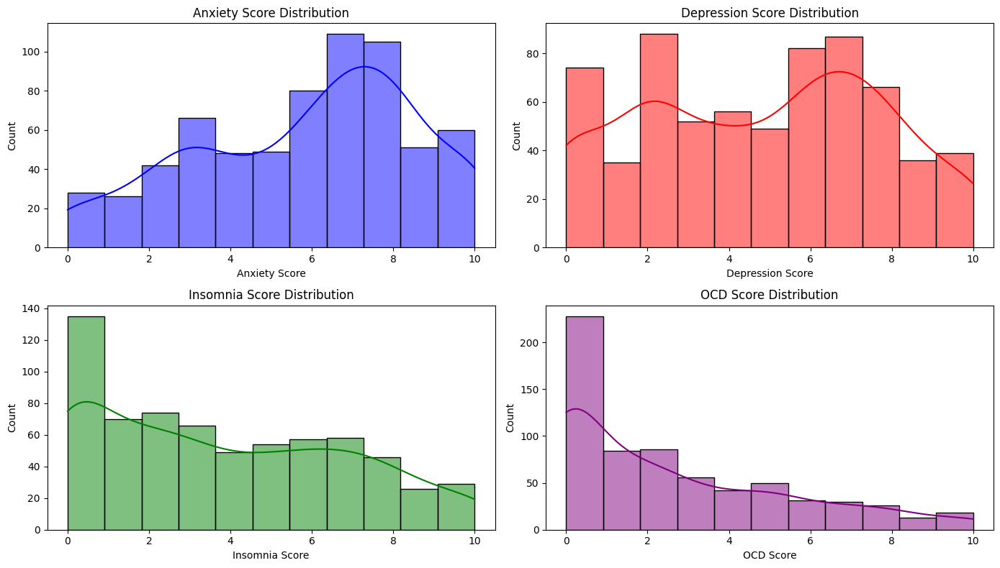

In [0]:
# Query 11: Get data for mental health score distributions using Spark DataFrame API
mental_health_dist = spark.table("music_mental_health") \
    .select("Anxiety", "Depression", "Insomnia", "OCD") \
    .filter("Anxiety IS NOT NULL AND Depression IS NOT NULL AND Insomnia IS NOT NULL AND OCD IS NOT NULL") \
    .toPandas()

# Visualization with matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(14, 8))

# Create subplots for each mental health condition
plt.subplot(2, 2, 1)
sns.histplot(mental_health_dist['Anxiety'], kde=True, color='blue')
plt.title('Anxiety Score Distribution')
plt.xlabel('Anxiety Score')

plt.subplot(2, 2, 2)
sns.histplot(mental_health_dist['Depression'], kde=True, color='red')
plt.title('Depression Score Distribution')
plt.xlabel('Depression Score')

plt.subplot(2, 2, 3)
sns.histplot(mental_health_dist['Insomnia'], kde=True, color='green')
plt.title('Insomnia Score Distribution')
plt.xlabel('Insomnia Score')

plt.subplot(2, 2, 4)
sns.histplot(mental_health_dist['OCD'], kde=True, color='purple')
plt.title('OCD Score Distribution')
plt.xlabel('OCD Score')

plt.tight_layout()
plt.show()


2. Age Distribution

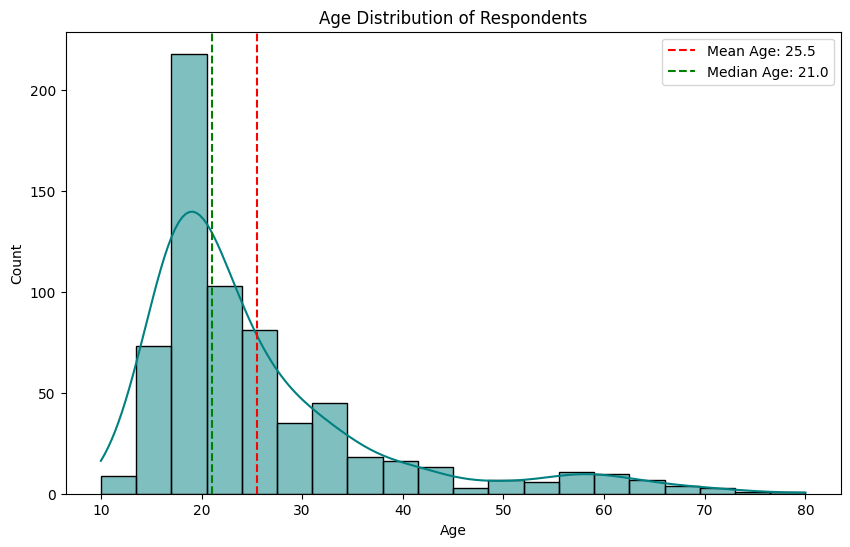

In [0]:
# Query 12: Get age distribution data using Spark DataFrame API
age_dist = spark.table("music_mental_health") \
    .select("Age") \
    .filter(col("Age").isNotNull()) \
    .toPandas()

# Visualization with matplotlib
plt.figure(figsize=(10, 6))
sns.histplot(age_dist['Age'], bins=20, kde=True, color='teal')
plt.title('Age Distribution of Respondents')
plt.xlabel('Age')
plt.ylabel('Count')
plt.axvline(x=age_dist['Age'].mean(), color='red', linestyle='--', label=f'Mean Age: {age_dist["Age"].mean():.1f}')
plt.axvline(x=age_dist['Age'].median(), color='green', linestyle='--', label=f'Median Age: {age_dist["Age"].median():.1f}')
plt.legend()
plt.show()


3. Hours Per Day Distribution

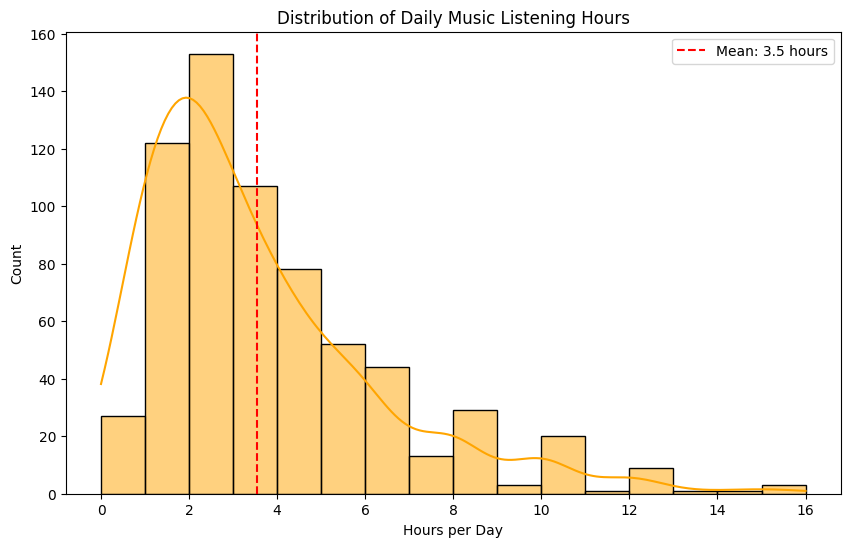

In [0]:
hours_dist = spark.table("music_mental_health") \
    .select("`Hours per day`") \
    .filter(col("Hours per day").isNotNull() & (col("Hours per day") <= 16)) \
    .toPandas()

# Visualization with matplotlib
plt.figure(figsize=(10, 6))
sns.histplot(hours_dist['Hours per day'], bins=16, kde=True, color='orange')
plt.title('Distribution of Daily Music Listening Hours')
plt.xlabel('Hours per Day')
plt.ylabel('Count')
plt.axvline(x=hours_dist['Hours per day'].mean(), color='red', linestyle='--', 
            label=f'Mean: {hours_dist["Hours per day"].mean():.1f} hours')
plt.legend()
plt.show()

4. Favorite Genre Distribution

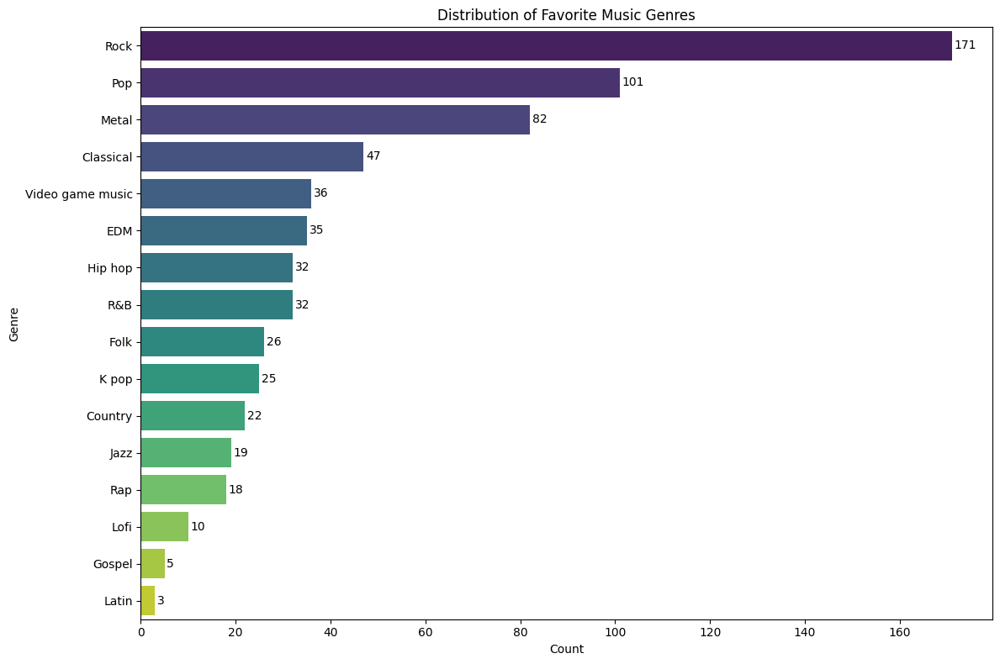

In [0]:
from pyspark.sql.functions import col, count, desc
genre_dist = spark.table("music_mental_health") \
    .groupBy(col("Fav genre").alias("genre")) \
    .agg(count("*").alias("count")) \
    .orderBy(desc("count")) \
    .toPandas()

# Visualization with matplotlib
plt.figure(figsize=(12, 8))
chart = sns.barplot(x='count', y='genre', data=genre_dist, palette='viridis')
plt.title('Distribution of Favorite Music Genres')
plt.xlabel('Count')
plt.ylabel('Genre')

# Add count labels to the bars
for i, v in enumerate(genre_dist['count']):
    chart.text(v + 0.5, i, str(v), color='black', va='center')

plt.tight_layout()
plt.show()

5. Correlation Between Hours of Listening and Mental Health

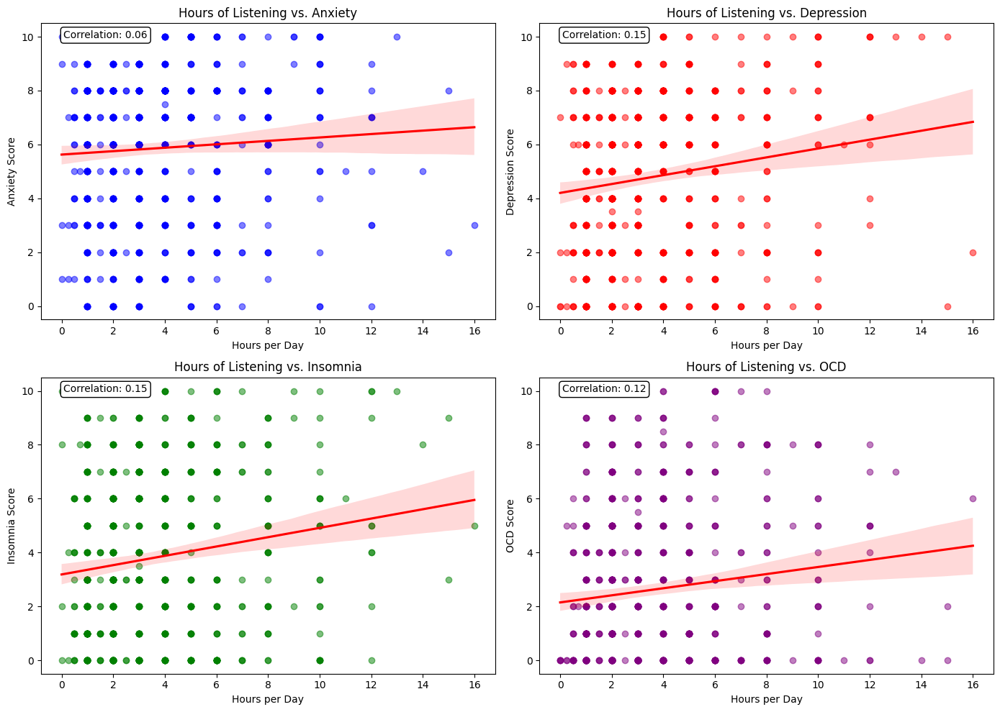

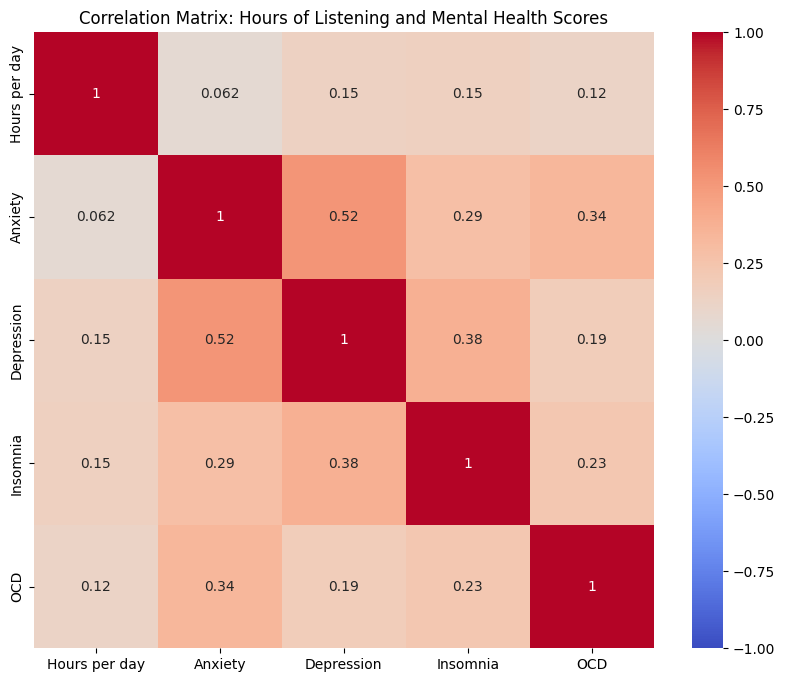

In [0]:
# Query 15: Get data for correlation analysis using Spark DataFrame API

hours_mental_health_corr = spark.table("music_mental_health") \
    .select("`Hours per day`", "Anxiety", "Depression", "Insomnia", "OCD") \
    .filter(col("Hours per day").isNotNull() & 
            (col("Hours per day") <= 16) &
            col("Anxiety").isNotNull() & 
            col("Depression").isNotNull() & 
            col("Insomnia").isNotNull() & 
            col("OCD").isNotNull()) \
    .toPandas()

# Visualization with matplotlib
plt.figure(figsize=(14, 10))

# Create scatter plots for each mental health condition vs. hours
conditions = ['Anxiety', 'Depression', 'Insomnia', 'OCD']
colors = ['blue', 'red', 'green', 'purple']

for i, condition in enumerate(conditions):
    plt.subplot(2, 2, i+1)
    sns.regplot(x='Hours per day', y=condition, data=hours_mental_health_corr, 
                scatter_kws={'alpha':0.5}, line_kws={'color':'red'}, color=colors[i])
    plt.title(f'Hours of Listening vs. {condition}')
    plt.xlabel('Hours per Day')
    plt.ylabel(f'{condition} Score')
    
    # Calculate and display correlation coefficient
    corr = hours_mental_health_corr['Hours per day'].corr(hours_mental_health_corr[condition])
    plt.annotate(f'Correlation: {corr:.2f}', xy=(0.05, 0.95), xycoords='axes fraction', 
                 fontsize=10, bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="black", lw=1))

plt.tight_layout()
plt.show()

# Create correlation heatmap
plt.figure(figsize=(10, 8))
correlation_matrix = hours_mental_health_corr.corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1, center=0)
plt.title('Correlation Matrix: Hours of Listening and Mental Health Scores')
plt.show()


6. Mental Health Scores by Music Effect

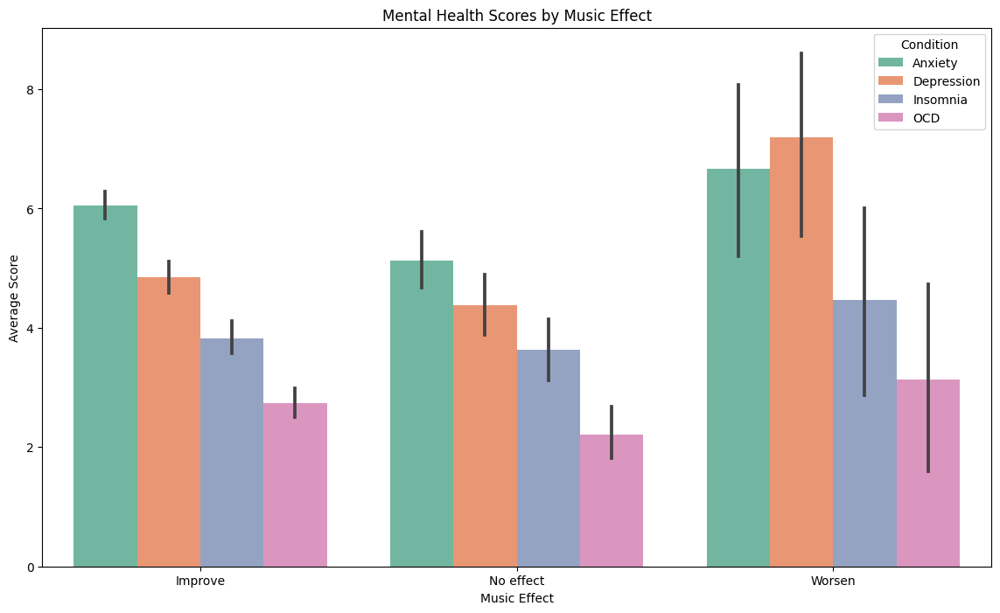

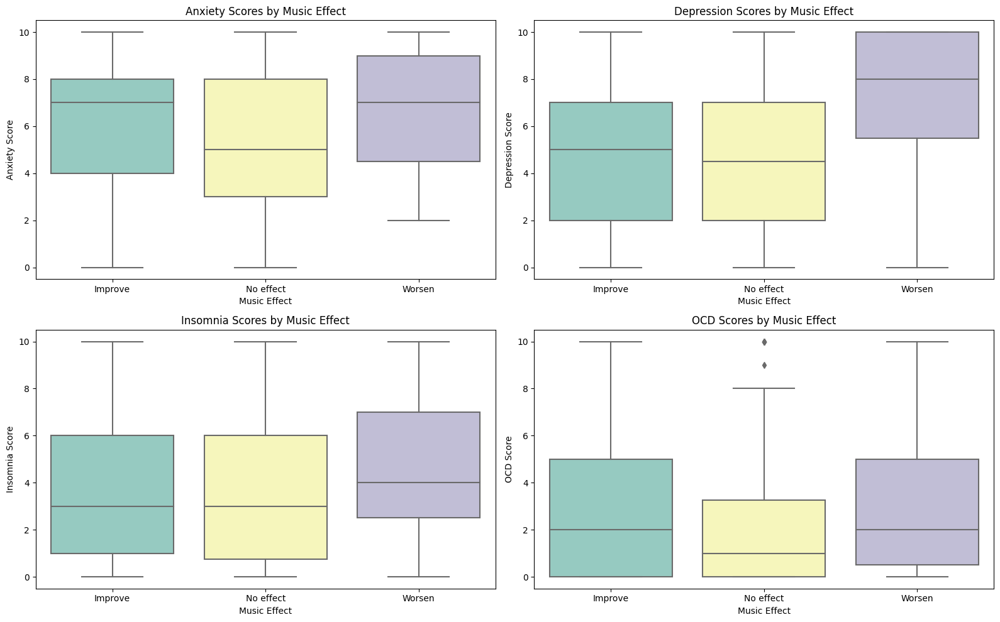

In [0]:
# Query 16: Get mental health scores by music effect using Spark DataFrame API
from pyspark.sql.functions import col

effect_scores = spark.table("music_mental_health") \
    .select("`Music effects`", "Anxiety", "Depression", "Insomnia", "OCD") \
    .filter(col("Music effects").isNotNull() &
            col("Anxiety").isNotNull() & 
            col("Depression").isNotNull() & 
            col("Insomnia").isNotNull() & 
            col("OCD").isNotNull()) \
    .toPandas()

# Visualization with matplotlib
plt.figure(figsize=(14, 8))

# Reshape data for easier plotting
melted_data = pd.melt(effect_scores, id_vars=['Music effects'], 
                      value_vars=['Anxiety', 'Depression', 'Insomnia', 'OCD'],
                      var_name='Condition', value_name='Score')

# Create grouped bar plot
sns.barplot(x='Music effects', y='Score', hue='Condition', data=melted_data, palette='Set2')
plt.title('Mental Health Scores by Music Effect')
plt.xlabel('Music Effect')
plt.ylabel('Average Score')
plt.show()

# Create boxplots for each condition by music effect
plt.figure(figsize=(16, 10))
for i, condition in enumerate(['Anxiety', 'Depression', 'Insomnia', 'OCD']):
    plt.subplot(2, 2, i+1)
    sns.boxplot(x='Music effects', y=condition, data=effect_scores, palette='Set3')
    plt.title(f'{condition} Scores by Music Effect')
    plt.xlabel('Music Effect')
    plt.ylabel(f'{condition} Score')

plt.tight_layout()
plt.show()


7. BPM vs Mental Health Scores

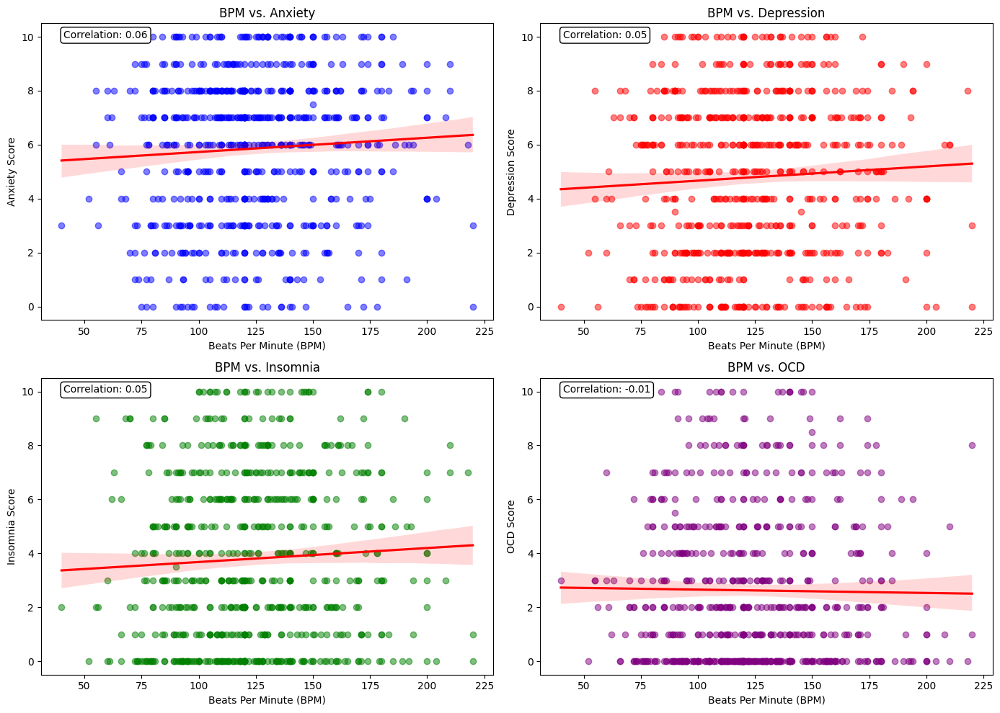

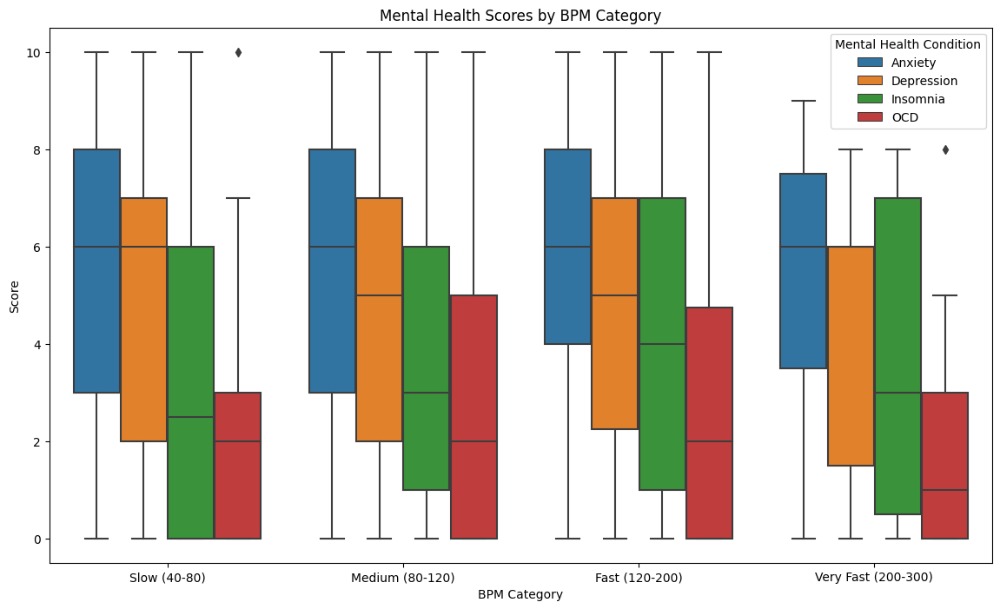

In [0]:
bpm_scores = spark.table("music_mental_health") \
    .select("BPM", "Anxiety", "Depression", "Insomnia", "OCD") \
    .filter(col("BPM").isNotNull() & 
            (col("BPM").between(40, 300)) &
            col("Anxiety").isNotNull() & 
            col("Depression").isNotNull() & 
            col("Insomnia").isNotNull() & 
            col("OCD").isNotNull()) \
    .toPandas()

# Visualization with matplotlib
plt.figure(figsize=(14, 10))

# Create scatter plots for each mental health condition vs. BPM
conditions = ['Anxiety', 'Depression', 'Insomnia', 'OCD']
colors = ['blue', 'red', 'green', 'purple']

for i, condition in enumerate(conditions):
    plt.subplot(2, 2, i+1)
    sns.regplot(x='BPM', y=condition, data=bpm_scores, 
                scatter_kws={'alpha':0.5}, line_kws={'color':'red'}, color=colors[i])
    plt.title(f'BPM vs. {condition}')
    plt.xlabel('Beats Per Minute (BPM)')
    plt.ylabel(f'{condition} Score')
    
    # Calculate and display correlation coefficient
    corr = bpm_scores['BPM'].corr(bpm_scores[condition])
    plt.annotate(f'Correlation: {corr:.2f}', xy=(0.05, 0.95), xycoords='axes fraction', 
                 fontsize=10, bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="black", lw=1))

plt.tight_layout()
plt.show()

# Create BPM category analysis
bpm_scores['BPM_Category'] = pd.cut(bpm_scores['BPM'], 
                                    bins=[40, 80, 120, 200, 300],
                                    labels=['Slow (40-80)', 'Medium (80-120)', 
                                            'Fast (120-200)', 'Very Fast (200-300)'])

plt.figure(figsize=(14, 8))
sns.boxplot(x='BPM_Category', y='value', hue='variable', 
            data=pd.melt(bpm_scores, id_vars=['BPM_Category'], 
                         value_vars=['Anxiety', 'Depression', 'Insomnia', 'OCD']))
plt.title('Mental Health Scores by BPM Category')
plt.xlabel('BPM Category')
plt.ylabel('Score')
plt.legend(title='Mental Health Condition')
plt.show()


8. Genre Listening Frequency Heatmap

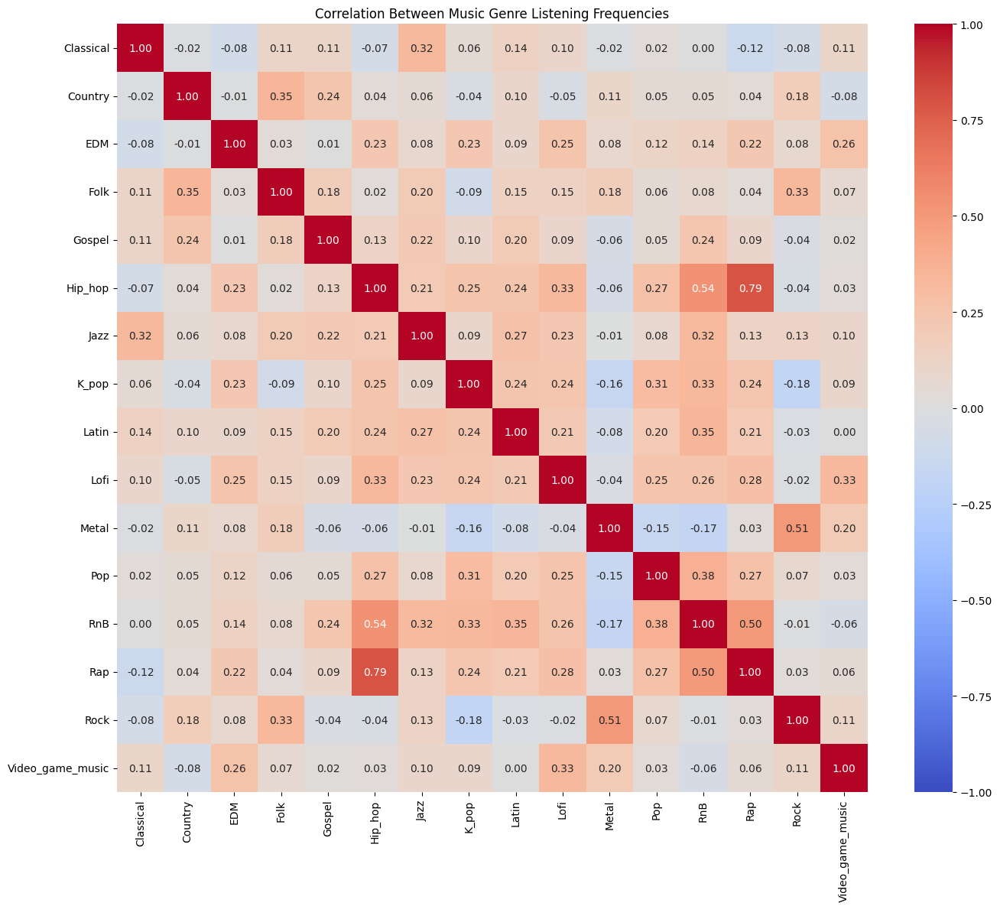

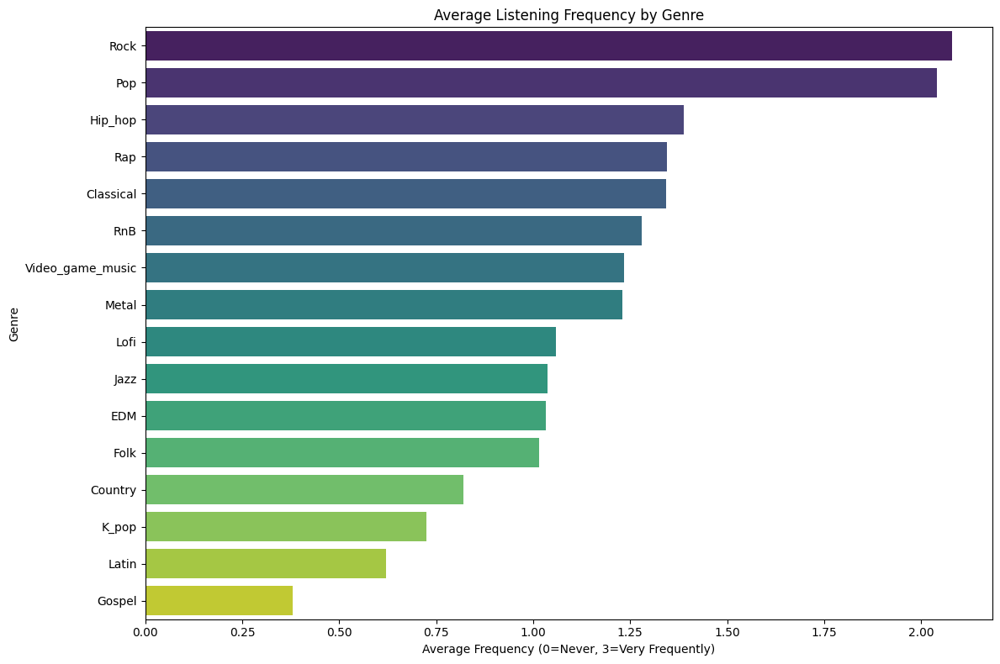

In [0]:

genre_freq_data = spark.table("music_mental_health") \
    .select(
        col("Frequency [Classical]_numeric").alias("Classical"),
        col("Frequency [Country]_numeric").alias("Country"),
        col("Frequency [EDM]_numeric").alias("EDM"),
        col("Frequency [Folk]_numeric").alias("Folk"),
        col("Frequency [Gospel]_numeric").alias("Gospel"),
        col("Frequency [Hip hop]_numeric").alias("Hip_hop"),
        col("Frequency [Jazz]_numeric").alias("Jazz"),
        col("Frequency [K pop]_numeric").alias("K_pop"),
        col("Frequency [Latin]_numeric").alias("Latin"),
        col("Frequency [Lofi]_numeric").alias("Lofi"),
        col("Frequency [Metal]_numeric").alias("Metal"),
        col("Frequency [Pop]_numeric").alias("Pop"),
        col("Frequency [R&B]_numeric").alias("RnB"),
        col("Frequency [Rap]_numeric").alias("Rap"),
        col("Frequency [Rock]_numeric").alias("Rock"),
        col("Frequency [Video game music]_numeric").alias("Video_game_music")
    ) \
    .toPandas()

# Visualization with matplotlib
plt.figure(figsize=(14, 12))

# Calculate correlation matrix between genres
genre_corr = genre_freq_data.corr()

# Create heatmap
sns.heatmap(genre_corr, annot=True, cmap='coolwarm', vmin=-1, vmax=1, center=0, fmt='.2f')
plt.title('Correlation Between Music Genre Listening Frequencies')
plt.tight_layout()
plt.show()

# Create average frequency by genre
plt.figure(figsize=(12, 8))
avg_frequencies = genre_freq_data.mean().sort_values(ascending=False)
sns.barplot(x=avg_frequencies.values, y=avg_frequencies.index, palette='viridis')
plt.title('Average Listening Frequency by Genre')
plt.xlabel('Average Frequency (0=Never, 3=Very Frequently)')
plt.ylabel('Genre')
plt.tight_layout()
plt.show()


9. Mental Health Score Distribution by Age Group

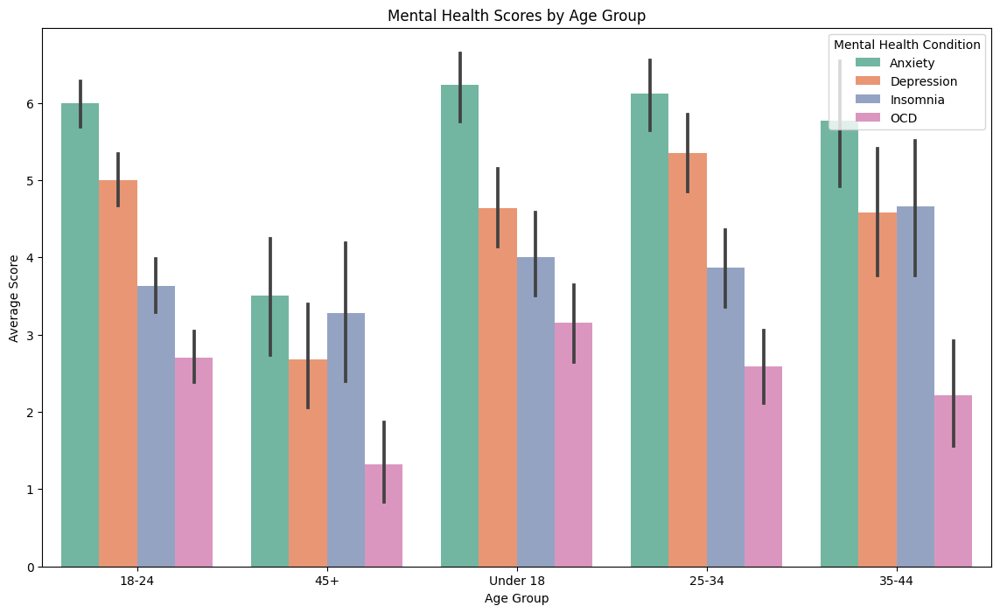

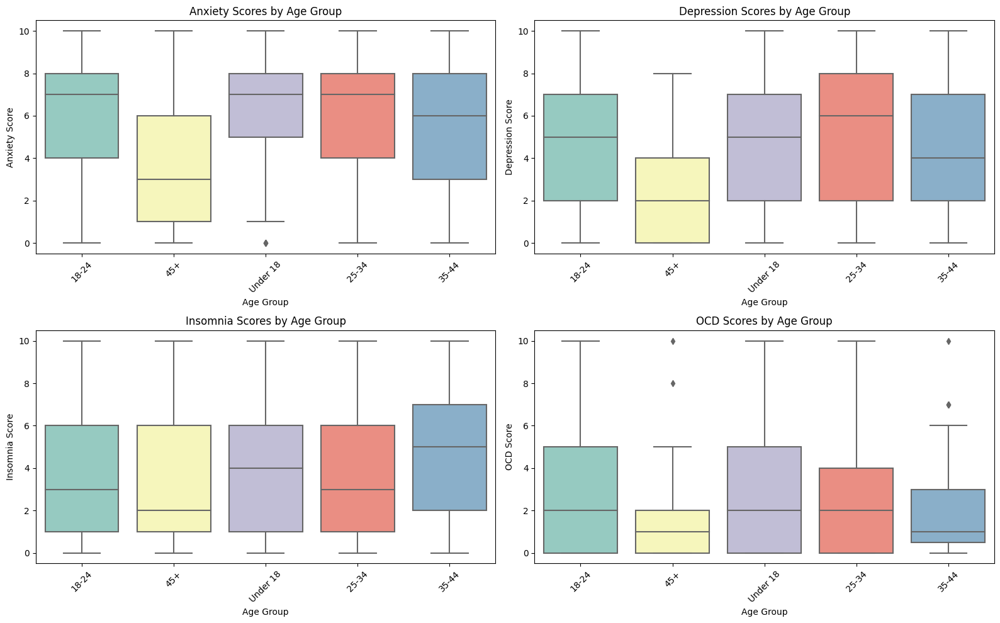

In [0]:
age_mental_health = spark.table("music_mental_health") \
    .select(
        when(col("Age") < 18, "Under 18")
        .when((col("Age") >= 18) & (col("Age") < 25), "18-24")
        .when((col("Age") >= 25) & (col("Age") < 35), "25-34")
        .when((col("Age") >= 35) & (col("Age") < 45), "35-44")
        .when(col("Age") >= 45, "45+")
        .otherwise("Unknown").alias("age_group"),
        "Anxiety", "Depression", "Insomnia", "OCD"
    ) \
    .filter(col("Age").isNotNull() &
            col("Anxiety").isNotNull() & 
            col("Depression").isNotNull() & 
            col("Insomnia").isNotNull() & 
            col("OCD").isNotNull()) \
    .toPandas()

# Visualization with matplotlib
plt.figure(figsize=(14, 8))

# Reshape data for easier plotting
melted_data = pd.melt(age_mental_health, id_vars=['age_group'], 
                      value_vars=['Anxiety', 'Depression', 'Insomnia', 'OCD'],
                      var_name='Condition', value_name='Score')

# Create grouped bar plot
sns.barplot(x='age_group', y='Score', hue='Condition', data=melted_data, palette='Set2')
plt.title('Mental Health Scores by Age Group')
plt.xlabel('Age Group')
plt.ylabel('Average Score')
plt.legend(title='Mental Health Condition')
plt.show()

# Create boxplots for each condition by age group
plt.figure(figsize=(16, 10))
for i, condition in enumerate(['Anxiety', 'Depression', 'Insomnia', 'OCD']):
    plt.subplot(2, 2, i+1)
    sns.boxplot(x='age_group', y=condition, data=age_mental_health, palette='Set3')
    plt.title(f'{condition} Scores by Age Group')
    plt.xlabel('Age Group')
    plt.ylabel(f'{condition} Score')
    plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


10. Streaming Service Popularity

In [0]:
from pyspark.sql.functions import col, count, desc

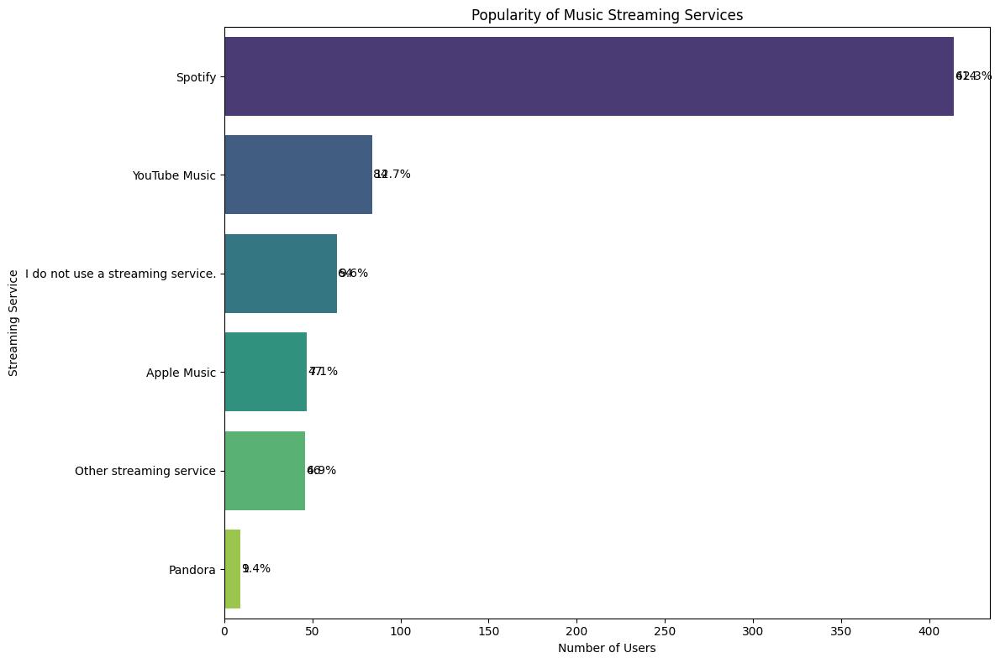

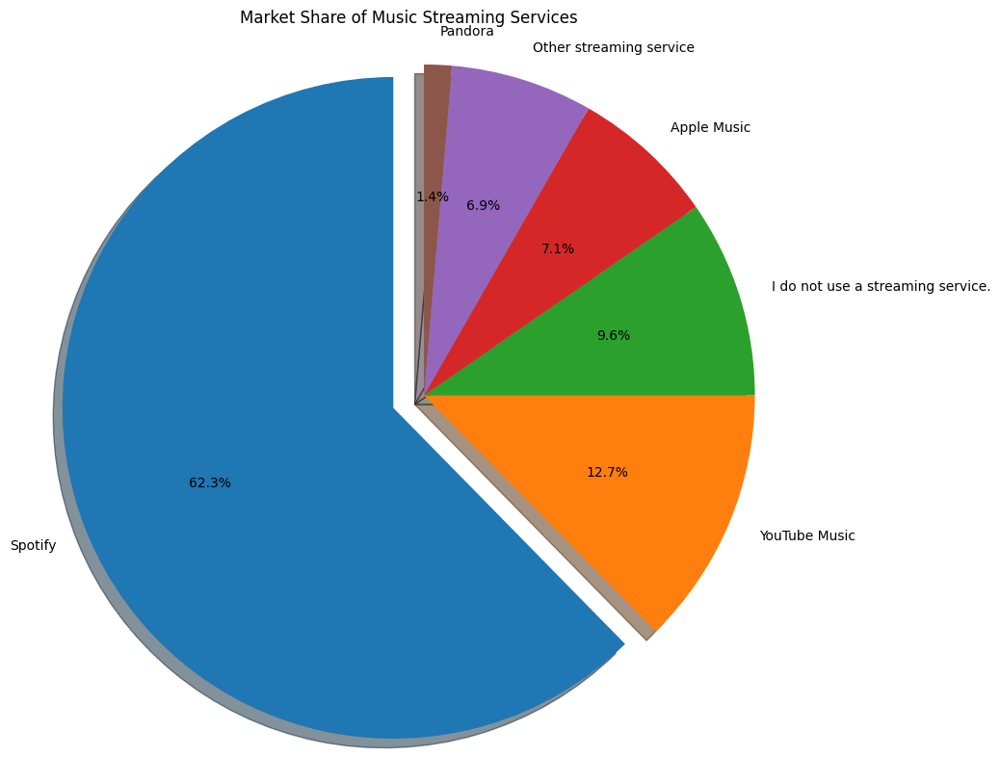

In [0]:
# Query 20: Get streaming service popularity data using Spark DataFrame API
from pyspark.sql.functions import col, count, desc
streaming_popularity = spark.table("music_mental_health") \
    .filter(col("Primary streaming service").isNotNull()) \
    .groupBy(col("Primary streaming service").alias("service")) \
    .agg(count("*").alias("count")) \
    .orderBy(desc("count")) \
    .toPandas()

# Visualization with matplotlib
plt.figure(figsize=(12, 8))
chart = sns.barplot(x='count', y='service', data=streaming_popularity, palette='viridis')
plt.title('Popularity of Music Streaming Services')
plt.xlabel('Number of Users')
plt.ylabel('Streaming Service')

# Add count labels to the bars
for i, v in enumerate(streaming_popularity['count']):
    chart.text(v + 0.5, i, str(v), color='black', va='center')

# Calculate and display percentages
total = streaming_popularity['count'].sum()
streaming_popularity['percentage'] = (streaming_popularity['count'] / total * 100).round(1)

for i, (count, percentage) in enumerate(zip(streaming_popularity['count'], streaming_popularity['percentage'])):
    chart.text(count + 1, i, f"{percentage}%", color='black', va='center')

plt.tight_layout()
plt.show()

# Create pie chart
plt.figure(figsize=(10, 10))
plt.pie(streaming_popularity['count'], labels=streaming_popularity['service'], 
        autopct='%1.1f%%', startangle=90, shadow=True, explode=[0.1 if i==0 else 0 for i in range(len(streaming_popularity))])
plt.axis('equal')
plt.title('Market Share of Music Streaming Services')
plt.show()


##Phase 4: Predictive Modeling using Spark MLlib

####1. Identifying At-Risk Individuals (Classification Approach)

In [0]:
##Data Prep
from pyspark.ml.feature import VectorAssembler, StringIndexer, OneHotEncoder
from pyspark.ml import Pipeline
from pyspark.ml.classification import RandomForestClassifier, LogisticRegression, GBTClassifier
from pyspark.ml.evaluation import MulticlassClassificationEvaluator, BinaryClassificationEvaluator
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator
from pyspark.sql.functions import col, when, expr


# Create a binary target variable for "at-risk" individuals
# Define "at-risk" as having a Mental_Health_Severity score > 20
risk_detection_df = risk_detection_df.withColumn("AtRisk",
when(col("Mental_Health_Severity") > 20, 1).otherwise(0))

# Display class distribution
risk_detection_df.groupBy("AtRisk").count().show()

# Select features for the model
feature_cols = [
"Age", "Hours per day", "BPM", "Genre_Diversity", "Genre_Contrast",
"Frequency [Classical]_numeric", "Frequency [Country]_numeric",
"Frequency [EDM]_numeric", "Frequency [Folk]_numeric",
"Frequency [Gospel]_numeric", "Frequency [Hip hop]_numeric",
"Frequency [Jazz]_numeric", "Frequency [K pop]_numeric",
"Frequency [Latin]_numeric", "Frequency [Lofi]_numeric",
"Frequency [Metal]_numeric", "Frequency [Pop]_numeric",
"Frequency [R&B]_numeric", "Frequency [Rap]_numeric",
"Frequency [Rock]_numeric", "Frequency [Video game music]_numeric",
"Music_Effect_Score"
]

# Create a vector assembler to combine all features into a single vector column
assembler = VectorAssembler(inputCols=feature_cols, outputCol="features")

# Split the data into training and testing sets
train_data, test_data = risk_detection_df.randomSplit([0.8, 0.2], seed=42)

+------+-----+
|AtRisk|count|
+------+-----+
|     1|  242|
|     0|  422|
+------+-----+



In [0]:

##Model Implementation
# 1. Random Forest Classifier
rf = RandomForestClassifier(labelCol="AtRisk", featuresCol="features", 
                           numTrees=100, maxDepth=10, seed=42)

# Create a pipeline
rf_pipeline = Pipeline(stages=[assembler, rf])

# Train the model
rf_model = rf_pipeline.fit(train_data)

# Make predictions
rf_predictions = rf_model.transform(test_data)

# 2. Logistic Regression
lr = LogisticRegression(labelCol="AtRisk", featuresCol="features", 
                        maxIter=10, regParam=0.01)

# Create a pipeline
lr_pipeline = Pipeline(stages=[assembler, lr])

# Train the model
lr_model = lr_pipeline.fit(train_data)

# Make predictions
lr_predictions = lr_model.transform(test_data)

# 3. Gradient Boosted Trees
gbt = GBTClassifier(labelCol="AtRisk", featuresCol="features", 
                   maxIter=10, maxDepth=5)

# Create a pipeline
gbt_pipeline = Pipeline(stages=[assembler, gbt])

# Train the model
gbt_model = gbt_pipeline.fit(train_data)

# Make predictions
gbt_predictions = gbt_model.transform(test_data)


Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

In [0]:
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator
from pyspark.ml.evaluation import BinaryClassificationEvaluator

# 1. Reduce the parameter search space for Random Forest
rf_param_grid = ParamGridBuilder() \
    .addGrid(rf.numTrees, [50, 100]) \
    .addGrid(rf.maxDepth, [5, 10]) \
    .addGrid(rf.impurity, ["gini"]) \
    .build()

# 2. Create CrossValidator for Random Forest
rf_cv = CrossValidator(estimator=rf_pipeline,
                      estimatorParamMaps=rf_param_grid,
                      evaluator=BinaryClassificationEvaluator(labelCol="AtRisk"),
                      numFolds=3,
                      parallelism=4)

# 3. Sample the training data to speed up initial exploration
train_sample = train_data.sample(fraction=0.5, seed=42)

# 4. Train the model on the sampled data
print("Training Random Forest model...")
optimized_rf_model = rf_cv.fit(train_sample)

# 5. Evaluate the optimized model
print("Evaluating model...")
optimized_rf_predictions = optimized_rf_model.transform(test_data)

evaluator = BinaryClassificationEvaluator(labelCol="AtRisk")
optimized_rf_auc = evaluator.evaluate(optimized_rf_predictions)

print(f"Optimized Random Forest AUC: {optimized_rf_auc}")

# 6. Save the optimized model
print("Saving model...")
optimized_rf_model.write().overwrite().save("optimized_rf_model")

# 7. Get the best model directly from CrossValidator
# This avoids the parameter setting issue
best_model = optimized_rf_model.bestModel

# 8. Save the best model separately
best_model.write().overwrite().save("best_rf_model")


Training Random Forest model...


Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

Evaluating model...
Optimized Random Forest AUC: 0.5662042875157629
Saving model...


In [0]:
##Model Evaluation - normal model
# Make predictions with the best models
rf_predictions = rf_model.transform(test_data)
lr_predictions = lr_model.transform(test_data)
gbt_predictions = gbt_model.transform(test_data)

# Function to evaluate and print metrics
def evaluate_model(predictions, model_name):
    # Area under ROC
    auc_evaluator = BinaryClassificationEvaluator(
        labelCol="AtRisk", 
        rawPredictionCol="rawPrediction", 
        metricName="areaUnderROC"
    )
    auc = auc_evaluator.evaluate(predictions)
    
    # Area under PR
    pr_evaluator = BinaryClassificationEvaluator(
        labelCol="AtRisk", 
        rawPredictionCol="rawPrediction", 
        metricName="areaUnderPR"
    )
    pr = pr_evaluator.evaluate(predictions)
    
    # Accuracy
    multi_evaluator = MulticlassClassificationEvaluator(
        labelCol="AtRisk", 
        predictionCol="prediction", 
        metricName="accuracy"
    )
    accuracy = multi_evaluator.evaluate(predictions)
    
    # F1 Score
    f1_evaluator = MulticlassClassificationEvaluator(
        labelCol="AtRisk", 
        predictionCol="prediction", 
        metricName="f1"
    )
    f1 = f1_evaluator.evaluate(predictions)
    
    # Create a confusion matrix
    confusion_matrix = predictions.groupBy("AtRisk", "prediction").count().orderBy("AtRisk", "prediction")
    
    print(f"Model: {model_name}")
    print(f"Area under ROC: {auc:.4f}")
    print(f"Area under PR: {pr:.4f}")
    print(f"Accuracy: {accuracy:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print("Confusion Matrix:")
    confusion_matrix.show()
    print("-" * 50)
    
    return {"auc": auc, "pr": pr, "accuracy": accuracy, "f1": f1}

# Evaluate all models
rf_metrics = evaluate_model(rf_predictions, "Random Forest")
lr_metrics = evaluate_model(lr_predictions, "Logistic Regression")
gbt_metrics = evaluate_model(gbt_predictions, "Gradient Boosted Trees")

# Compare models
models_comparison = spark.createDataFrame([
    ("Random Forest", rf_metrics["auc"], rf_metrics["pr"], rf_metrics["accuracy"], rf_metrics["f1"]),
    ("Logistic Regression", lr_metrics["auc"], lr_metrics["pr"], lr_metrics["accuracy"], lr_metrics["f1"]),
    ("Gradient Boosted Trees", gbt_metrics["auc"], gbt_metrics["pr"], gbt_metrics["accuracy"], gbt_metrics["f1"])
], ["Model", "AUC", "PR", "Accuracy", "F1"])

models_comparison.display()


Model: Random Forest
Area under ROC: 0.5355
Area under PR: 0.4892
Accuracy: 0.5683
F1 Score: 0.4620
Confusion Matrix:
+------+----------+-----+
|AtRisk|prediction|count|
+------+----------+-----+
|     0|       0.0|   74|
|     0|       1.0|    4|
|     1|       0.0|   56|
|     1|       1.0|    5|
+------+----------+-----+

--------------------------------------------------
Model: Logistic Regression
Area under ROC: 0.5448
Area under PR: 0.4982
Accuracy: 0.5612
F1 Score: 0.4744
Confusion Matrix:
+------+----------+-----+
|AtRisk|prediction|count|
+------+----------+-----+
|     0|       0.0|   71|
|     0|       1.0|    7|
|     1|       0.0|   54|
|     1|       1.0|    7|
+------+----------+-----+

--------------------------------------------------
Model: Gradient Boosted Trees
Area under ROC: 0.5153
Area under PR: 0.4402
Accuracy: 0.5540
F1 Score: 0.5172
Confusion Matrix:
+------+----------+-----+
|AtRisk|prediction|count|
+------+----------+-----+
|     0|       0.0|   62|
|     0

Model,AUC,PR,Accuracy,F1
Random Forest,0.53551912568306,0.48922400640640623,0.5683453237410072,0.4619732785200411
Logistic Regression,0.544766708701135,0.49824722259585474,0.5611510791366906,0.47444779152047817
Gradient Boosted Trees,0.5153425809163513,0.44015948769667174,0.5539568345323741,0.5172036284016265


In [0]:
##Model Evaluation - Tuned model
# Make predictions with the optimized models
optimized_rf_predictions = optimized_rf_model.transform(test_data)

# Function to evaluate and print metrics
def evaluate_model(predictions, model_name):
    # Area under ROC
    auc_evaluator = BinaryClassificationEvaluator(
        labelCol="AtRisk", 
        rawPredictionCol="rawPrediction", 
        metricName="areaUnderROC"
    )
    auc = auc_evaluator.evaluate(predictions)
    
    # Area under PR
    pr_evaluator = BinaryClassificationEvaluator(
        labelCol="AtRisk", 
        rawPredictionCol="rawPrediction", 
        metricName="areaUnderPR"
    )
    pr = pr_evaluator.evaluate(predictions)
    
    # Accuracy
    multi_evaluator = MulticlassClassificationEvaluator(
        labelCol="AtRisk", 
        predictionCol="prediction", 
        metricName="accuracy"
    )
    accuracy = multi_evaluator.evaluate(predictions)
    
    # F1 Score
    f1_evaluator = MulticlassClassificationEvaluator(
        labelCol="AtRisk", 
        predictionCol="prediction", 
        metricName="f1"
    )
    f1 = f1_evaluator.evaluate(predictions)
    
    # Create a confusion matrix
    confusion_matrix = predictions.groupBy("AtRisk", "prediction").count().orderBy("AtRisk", "prediction")
    
    print(f"Model: {model_name}")
    print(f"Area under ROC: {auc:.4f}")
    print(f"Area under PR: {pr:.4f}")
    print(f"Accuracy: {accuracy:.4f}")
    print(f"F1 Score: {f1:.4f}")
    print("Confusion Matrix:")
    confusion_matrix.show()
    print("-" * 50)
    
    return {"auc": auc, "pr": pr, "accuracy": accuracy, "f1": f1}

# Evaluate model
rf_metrics = evaluate_model(optimized_rf_predictions, "Random Forest")




Model: Random Forest
Area under ROC: 0.5662
Area under PR: 0.5333
Accuracy: 0.5827
F1 Score: 0.4799
Confusion Matrix:
+------+----------+-----+
|AtRisk|prediction|count|
+------+----------+-----+
|     0|       0.0|   75|
|     0|       1.0|    3|
|     1|       0.0|   55|
|     1|       1.0|    6|
+------+----------+-----+

--------------------------------------------------


In [0]:
# Extract feature importance from the Random Forest model (normal model)
if "RandomForestClassificationModel" in str(type(rf_model.stages[-1])):
    feature_importances = rf_model.stages[-1].featureImportances
    
    # Create a DataFrame with feature names and their importance
    feature_importance_df = spark.createDataFrame(
        [(feature_cols[i], float(feature_importances[i])) for i in range(len(feature_cols))],
        ["feature", "importance"]
    )
    
    # Sort by importance in descending order
    feature_importance_df = feature_importance_df.orderBy(col("importance").desc())
    
    # Show the top 10 most important features
    print("Top 10 Most Important Features:")
    feature_importance_df.display(10)


Top 10 Most Important Features:


feature,importance
Age,0.12323380189267186
BPM,0.0985215271423716
Hours per day,0.09542312594839324
Genre_Diversity,0.058453479820173675
Frequency [Video game music]_numeric,0.04603756191923559
Frequency [Classical]_numeric,0.04559489814504411
Frequency [Metal]_numeric,0.043033282380117485
Frequency [EDM]_numeric,0.04183022603989161
Frequency [Jazz]_numeric,0.03937837221121217
Frequency [Folk]_numeric,0.03871518362050137


Databricks visualization. Run in Databricks to view.

In [0]:
# Extract feature importance from the Random Forest model (optimized performing model)
best_model = optimized_rf_model.bestModel

if "RandomForestClassificationModel" in str(type(best_model.stages[-1])):
    feature_importances = best_model.stages[-1].featureImportances
    
    # Create a DataFrame with feature names and their importance
    feature_importance_df = spark.createDataFrame(
        [(feature_cols[i], float(feature_importances[i])) for i in range(len(feature_cols))],
        ["feature", "importance"]
    )
    
    # Sort by importance in descending order
    feature_importance_df = feature_importance_df.orderBy(col("importance").desc())
    
    # Show the top 10 most important features
    print("Top 10 Most Important Features:")
    feature_importance_df.display()


Top 10 Most Important Features:


feature,importance
Hours per day,0.13500915251430556
Age,0.11597091787063157
BPM,0.08970369507708435
Frequency [Folk]_numeric,0.06494628350977445
Genre_Diversity,0.06080178548305688
Frequency [Classical]_numeric,0.04533024648614039
Frequency [EDM]_numeric,0.04210286422250564
Frequency [Metal]_numeric,0.040446420922115305
Frequency [Latin]_numeric,0.0381405450969453
Frequency [R&B]_numeric,0.03771333851402595


Databricks visualization. Run in Databricks to view.

In [0]:
# For the normal model
# Get the predictions with probability
predictions = rf_model.transform(test_data)

# Create a temporary view for SQL analysis
predictions.createOrReplaceTempView("predictions")

# Calculate metrics at different thresholds
thresholds = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
threshold_metrics = []

from pyspark.sql.functions import col, udf
from pyspark.sql.types import DoubleType, ArrayType
import pyspark.sql.functions as F

# Extract the probability for the positive class
# First, we need to convert the ML vector to an array
get_array = udf(lambda v: v.toArray().tolist(), ArrayType(DoubleType()))
predictions = predictions.withColumn("probability_array", get_array(col("probability")))

# Now we can get the probability for the positive class (index 1)
predictions = predictions.withColumn("prob_positive", col("probability_array")[1])

# Register the updated DataFrame as a view
predictions.createOrReplaceTempView("predictions")

for threshold in thresholds:
    # Create predictions based on the current threshold
    threshold_preds = spark.sql(f"""
    SELECT 
        AtRisk,
        CASE WHEN prob_positive > {threshold} THEN 1 ELSE 0 END as prediction
    FROM predictions
    """)
    
    # Calculate metrics
    tp = threshold_preds.filter("AtRisk = 1 AND prediction = 1").count()
    fp = threshold_preds.filter("AtRisk = 0 AND prediction = 1").count()
    tn = threshold_preds.filter("AtRisk = 0 AND prediction = 0").count()
    fn = threshold_preds.filter("AtRisk = 1 AND prediction = 0").count()
    
    # Calculate precision, recall, and F1
    precision = float(tp) / float(tp + fp) if (tp + fp) > 0 else 0.0
    recall = float(tp) / float(tp + fn) if (tp + fn) > 0 else 0.0
    f1 = 2.0 * precision * recall / (precision + recall) if (precision + recall) > 0 else 0.0
    
    threshold_metrics.append((float(threshold), float(precision), float(recall), float(f1)))

# Create a DataFrame with the metrics
threshold_df = spark.createDataFrame(threshold_metrics, ["threshold", "precision", "recall", "f1"])
threshold_df.display()

# Find the threshold with the highest F1 score
best_threshold = threshold_df.orderBy(col("f1").desc()).first()["threshold"]
print(f"Best threshold: {best_threshold}")


threshold,precision,recall,f1
0.1,0.44525547445255476,1.0,0.6161616161616161
0.2,0.4573643410852713,0.9672131147540983,0.6210526315789474
0.3,0.4742268041237113,0.7540983606557377,0.5822784810126582
0.4,0.43478260869565216,0.32786885245901637,0.37383177570093457
0.5,0.5555555555555556,0.08196721311475409,0.14285714285714285
0.6,1.0,0.01639344262295082,0.03225806451612903
0.7,1.0,0.01639344262295082,0.03225806451612903
0.8,0.0,0.0,0.0
0.9,0.0,0.0,0.0


Best threshold: 0.2


In [0]:

# For the optimized model (assuming Random Forest), optimize the prediction threshold
# Get the predictions with probability
optimized_predictions = optimized_rf_model.transform(test_data)

# Extract the probability for the positive class
# First, we need to convert the ML vector to an array
get_array = udf(lambda v: v.toArray().tolist(), ArrayType(DoubleType()))
optimized_predictions = optimized_predictions.withColumn("probability_array", get_array(col("probability")))

# Now we can get the probability for the positive class (index 1)
optimized_predictions = optimized_predictions.withColumn("prob_positive", col("probability_array")[1])

# Create a temporary view for SQL analysis
optimized_predictions.createOrReplaceTempView("predictions")

# Calculate metrics at different thresholds
thresholds = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
threshold_metrics = []

for threshold in thresholds:
    # Create predictions based on the current threshold
    threshold_preds = spark.sql(f"""
    SELECT 
        AtRisk,
        CASE WHEN prob_positive > {threshold} THEN 1 ELSE 0 END as prediction
    FROM predictions
    """)
    
    # Calculate metrics
    tp = threshold_preds.filter("AtRisk = 1 AND prediction = 1").count()
    fp = threshold_preds.filter("AtRisk = 0 AND prediction = 1").count()
    tn = threshold_preds.filter("AtRisk = 0 AND prediction = 0").count()
    fn = threshold_preds.filter("AtRisk = 1 AND prediction = 0").count()
    
    # Calculate precision, recall, and F1
    precision = float(tp) / float(tp + fp) if (tp + fp) > 0 else 0.0
    recall = float(tp) / float(tp + fn) if (tp + fn) > 0 else 0.0
    f1 = 2.0 * precision * recall / (precision + recall) if (precision + recall) > 0 else 0.0
    
    threshold_metrics.append((float(threshold), float(precision), float(recall), float(f1)))

# Create a DataFrame with the metrics
threshold_df = spark.createDataFrame(threshold_metrics, ["threshold", "precision", "recall", "f1"])
threshold_df.display()

# Find the threshold with the highest F1 score
optimized_threshold = threshold_df.orderBy(col("f1").desc()).first()["threshold"]
print(f"optimized threshold: {optimized_threshold}")


threshold,precision,recall,f1
0.1,0.43884892086330934,1.0,0.61
0.2,0.43703703703703706,0.9672131147540983,0.6020408163265306
0.3,0.46236559139784944,0.7049180327868853,0.5584415584415585
0.4,0.5294117647058824,0.29508196721311475,0.37894736842105264
0.5,0.6666666666666666,0.09836065573770492,0.1714285714285714
0.6,1.0,0.01639344262295082,0.03225806451612903
0.7,0.0,0.0,0.0
0.8,0.0,0.0,0.0
0.9,0.0,0.0,0.0


optimized threshold: 0.1


In [0]:
def predict_risk(age, hours_per_day, bpm, genre_frequencies, music_effect):
    """
    Function to predict if an individual is at risk based on their music listening habits.
    
    Parameters:
    - age: Age of the individual
    - hours_per_day: Hours spent listening to music per day
    - bpm: Beats per minute of favorite genre
    - genre_frequencies: Dictionary mapping genre names to frequency scores (0-3)
    - music_effect: Effect of music on mental health (-1, 0, 1)
    
    Returns:
    - Probability of being at risk
    - Binary prediction (at risk or not)
    """
    # Create a sample row with the input data
    sample_data = spark.createDataFrame([(
        age, 
        hours_per_day, 
        bpm,
        # Calculate genre diversity
        sum(1 for freq in genre_frequencies.values() if freq >= 2),
        # Calculate genre contrast
        max(genre_frequencies.values()) - min(genre_frequencies.values()),
        # Add all genre frequencies
        genre_frequencies.get("Classical", 0),
        genre_frequencies.get("Country", 0),
        genre_frequencies.get("EDM", 0),
        genre_frequencies.get("Folk", 0),
        genre_frequencies.get("Gospel", 0),
        genre_frequencies.get("Hip hop", 0),
        genre_frequencies.get("Jazz", 0),
        genre_frequencies.get("K pop", 0),
        genre_frequencies.get("Latin", 0),
        genre_frequencies.get("Lofi", 0),
        genre_frequencies.get("Metal", 0),
        genre_frequencies.get("Pop", 0),
        genre_frequencies.get("R&B", 0),
        genre_frequencies.get("Rap", 0),
        genre_frequencies.get("Rock", 0),
        genre_frequencies.get("Video game music", 0),
        music_effect,
        0  # Placeholder for AtRisk label
    )], feature_cols + ["AtRisk"])
    
    # Make prediction
    prediction = rf_model.transform(sample_data)
    
    # Extract probability and prediction
    result = prediction.select("probability", "prediction").first()
    
    at_risk_prob = result["probability"][1]
    is_at_risk = at_risk_prob > threshold
    
    # Print detailed results
    print("Prediction Result:")
    print(f"Raw result: {result}")
    print(f"Probability of being at risk: {at_risk_prob:.4f}")
    print(f"Risk threshold: {threshold}")
    print(f"Is at risk: {is_at_risk}")
    
    return at_risk_prob, is_at_risk

    # Example usage
sample_genre_frequencies = {
    "Classical": 0,
    "Country": 0,
    "EDM": 2,
    "Folk": 0,
    "Gospel": 0,
    "Hip hop": 3,
    "Jazz": 1,
    "K pop": 0,
    "Latin": 0,
    "Lofi": 2,
    "Metal": 0,
    "Pop": 2,
    "R&B": 1,
    "Rap": 3,
    "Rock": 1,
    "Video game music": 0
}

# Call the function with sample values
risk_prob, is_at_risk = predict_risk(
    age=25, 
    hours_per_day=6, 
    bpm=120, 
    genre_frequencies=sample_genre_frequencies, 
    music_effect=1
)

print(f"\nSummary: Risk probability {risk_prob:.4f}, At risk: {is_at_risk}")



Prediction Result:
Raw result: Row(probability=DenseVector([0.4693, 0.5307]), prediction=1.0)
Probability of being at risk: 0.5307
Risk threshold: 0.9
Is at risk: False

Summary: Risk probability 0.5307, At risk: False


In [0]:
# Save the optimized model for deployment
optimized_model_path = "models/at_risk_prediction_model"
optimized_rf_model.write().overwrite().save(optimized_model_path)

# Create a sample prediction function
def predict_risk(age, hours_per_day, bpm, genre_frequencies, music_effect):
    """
    Function to predict if an individual is at risk based on their music listening habits.
    
    Parameters:
    - age: Age of the individual
    - hours_per_day: Hours spent listening to music per day
    - bpm: Beats per minute of favorite genre
    - genre_frequencies: Dictionary mapping genre names to frequency scores (0-3)
    - music_effect: Effect of music on mental health (-1, 0, 1)
    
    Returns:
    - Probability of being at risk
    - Binary prediction (at risk or not)
    """
    # Create a sample row with the input data
    sample_data = spark.createDataFrame([(
        age, 
        hours_per_day, 
        bpm,
        # Calculate genre diversity
        sum(1 for freq in genre_frequencies.values() if freq >= 2),
        # Calculate genre contrast
        max(genre_frequencies.values()) - min(genre_frequencies.values()),
        # Add all genre frequencies
        genre_frequencies.get("Classical", 0),
        genre_frequencies.get("Country", 0),
        genre_frequencies.get("EDM", 0),
        genre_frequencies.get("Folk", 0),
        genre_frequencies.get("Gospel", 0),
        genre_frequencies.get("Hip hop", 0),
        genre_frequencies.get("Jazz", 0),
        genre_frequencies.get("K pop", 0),
        genre_frequencies.get("Latin", 0),
        genre_frequencies.get("Lofi", 0),
        genre_frequencies.get("Metal", 0),
        genre_frequencies.get("Pop", 0),
        genre_frequencies.get("R&B", 0),
        genre_frequencies.get("Rap", 0),
        genre_frequencies.get("Rock", 0),
        genre_frequencies.get("Video game music", 0),
        music_effect,
        0  # Placeholder for AtRisk label
    )], feature_cols + ["AtRisk"])
    
    # Make prediction
    prediction = optimized_rf_model.transform(sample_data)
    
    # Extract probability and prediction
    result = prediction.select("probability", "prediction").first()
    
    at_risk_prob = result["probability"][1]
    is_at_risk = at_risk_prob > optimized_threshold
    
    return at_risk_prob, is_at_risk

        # Example usage
sample_genre_frequencies = {
    "Classical": 0,
    "Country": 0,
    "EDM": 2,
    "Folk": 0,
    "Gospel": 0,
    "Hip hop": 3,
    "Jazz": 1,
    "K pop": 0,
    "Latin": 0,
    "Lofi": 2,
    "Metal": 0,
    "Pop": 2,
    "R&B": 1,
    "Rap": 3,
    "Rock": 1,
    "Video game music": 0
}

# Call the function with sample values
risk_prob, is_at_risk = predict_risk(
    age=25, 
    hours_per_day=6, 
    bpm=120, 
    genre_frequencies=sample_genre_frequencies, 
    music_effect=1
)

print(f"\nSummary: Risk probability {risk_prob:.4f}, At risk: {is_at_risk}")





Summary: Risk probability 0.3441, At risk: True


In [0]:
mlflow.end_run()

In [0]:
# Set up MLflow tracking
import mlflow
import mlflow.spark
from mlflow.tracking import MlflowClient

# Define the path to your data
input_path = "/FileStore/music/mxmh_survey_results.csv"

# Function to log model performance metrics (without starting a new run)
def log_model_metrics(model_name, predictions, evaluator):
    """Logs model performance metrics to MLflow"""
    # Calculate metrics
    auc = evaluator.evaluate(predictions)
    precision = predictions.filter("AtRisk = 1 AND prediction = 1").count() / predictions.filter("prediction = 1").count() if predictions.filter("prediction = 1").count() > 0 else 0.0
    recall = predictions.filter("AtRisk = 1 AND prediction = 1").count() / predictions.filter("AtRisk = 1").count() if predictions.filter("AtRisk = 1").count() > 0 else 0.0

    # Log metrics
    mlflow.log_metric("auc", auc)
    mlflow.log_metric("precision", precision)
    mlflow.log_metric("recall", recall)

    # Print metrics
    print(f"{model_name} Metrics:")
    print(f"  AUC: {auc:.4f}")
    print(f"  Precision: {precision:.4f}")
    print(f"  Recall: {recall:.4f}")
    
    return {"auc": auc, "precision": precision, "recall": recall}

# Create data processing pipeline function
def create_data_processing_pipeline(input_path):
    """Creates the data processing pipeline"""
    # Load data
    df = (spark.read
          .format("csv")
          .option("header", "true")
          .option("inferSchema", "true")
          .load(input_path))

    # Clean and preprocess the data
    numeric_cols = ["Age", "Hours per day", "BPM", "Anxiety", "Depression", "Insomnia", "OCD"]
    for col_name in numeric_cols:
        df = df.withColumn(col_name, col(col_name).cast("double"))
        mean_val = df.select(F.mean(col(col_name))).first()[0]
        df = df.fillna({col_name: mean_val})

    categorical_cols = ["Primary streaming service", "While working", "Instrumentalist", "Composer", "Fav genre", "Exploratory", "Foreign languages", "Music effects"]
    for col_name in categorical_cols:
        mode_val = df.groupBy(col_name).count().orderBy("count", ascending=False).first()[0]
        df = df.fillna({col_name: mode_val})

    frequency_cols = [col for col in df.columns if col.startswith("Frequency")]
    frequency_mapping = {"Never": 0, "Rarely": 1, "Sometimes": 2, "Very frequently": 3}
    for col_name in frequency_cols:
        mapping_expr = create_map([lit(x) for x in chain(*frequency_mapping.items())])
        df = df.withColumn(col_name + "_numeric", mapping_expr[col(col_name)])

    df = df.withColumn("Genre_Diversity", sum([F.when(col(f"{c}_numeric") >= 2, 1).otherwise(0) for c in frequency_cols]))
    df = df.withColumn("Mental_Health_Severity", col("Anxiety") + col("Depression") + col("Insomnia") + col("OCD"))
    df = df.withColumn("Music_Effect_Score", when(col("Music effects") == "Improve", 1).when(col("Music effects") == "No effect", 0).when(col("Music effects") == "Worsen", -1).otherwise(0))
    df = df.withColumn("AtRisk", F.when(col("Mental_Health_Severity") > 20, 1).otherwise(0))

    # Prepare features
    numeric_features = ["Age", "Hours per day", "BPM", "Genre_Diversity", "Music_Effect_Score"] + [f"{col}_numeric" for col in frequency_cols]
    assembler = VectorAssembler(inputCols=numeric_features, outputCol="features", handleInvalid="skip")
    df = assembler.transform(df)

    return df

# Main function
def run_mlflow_tracking_pipeline(input_path):
    # Make sure no runs are active
    if mlflow.active_run():
        mlflow.end_run()

    # Create data processing pipeline
    data_df = create_data_processing_pipeline(input_path)

    # Split the data
    train_data, test_data = data_df.randomSplit([0.8, 0.2], seed=42)

    # Define Evaluator
    evaluator = BinaryClassificationEvaluator(labelCol="AtRisk", metricName="areaUnderROC")

    # Define models and parameters
    models = {
        "RandomForest": (RandomForestClassifier(labelCol="AtRisk", featuresCol="features", seed=42),
                         {"numTrees": 100, "maxDepth": 5}),
        "LogisticRegression": (LogisticRegression(labelCol="AtRisk", featuresCol="features"),
                              {"regParam": 0.01}),
        "GBTClassifier": (GBTClassifier(labelCol="AtRisk", featuresCol="features"),
                          {"maxDepth": 5, "maxIter": 10})
    }

    # Train, evaluate, and log models
    results = {}
    for model_name, (model, params) in models.items():
        with mlflow.start_run(run_name=model_name):
            print(f"Training {model_name}...")
            # Log parameters
            mlflow.log_params(params)
            
            # Train model
            trained_model = model.fit(train_data)
            
            # Make predictions
            predictions = trained_model.transform(test_data)
            
            # Log metrics
            metrics = log_model_metrics(model_name, predictions, evaluator)
            
            # Log model
            mlflow.spark.log_model(trained_model, "model")
            
            # Store run info
            run_id = mlflow.active_run().info.run_id
            results[model_name] = {"run_id": run_id, "metrics": metrics}

    # Find best model
    best_model_name = max(results, key=lambda k: results[k]["metrics"]["auc"])
    best_model_run_id = results[best_model_name]["run_id"]
    best_model_metrics = results[best_model_name]["metrics"]

    print(f"\nBest Model: {best_model_name}")
    print(f"Run ID: {best_model_run_id}")
    print(f"Metrics: {best_model_metrics}")

    # Save the best model to a file
    best_model_uri = f"runs:/{best_model_run_id}/model"
    best_model_path = "/FileStore/best_model"

# Run
run_mlflow_tracking_pipeline(input_path)


Training RandomForest...
RandomForest Metrics:
  AUC: 0.5835
  Precision: 0.4000
  Recall: 0.0400


2025/03/02 21:26:14 INFO mlflow.spark: Inferring pip requirements by reloading the logged model from the databricks artifact repository, which can be time-consuming. To speed up, explicitly specify the conda_env or pip_requirements when calling log_model().


2025/03/02 21:26:15 INFO mlflow.store.artifact.artifact_repo: The progress bar can be disabled by setting the environment variable MLFLOW_ENABLE_ARTIFACTS_PROGRESS_BAR to false
2025/03/02 21:26:35 WARNING mlflow.utils.environment: Encountered an unexpected error while inferring pip requirements (model URI: dbfs:/databricks/mlflow-tracking/4237428387742420/da2f446ad697446199a043d59fbede52/artifacts/model/sparkml, flavor: spark), fall back to return ['pyspark==3.5.0']. Set logging level to DEBUG to see the full traceback.


Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

Training LogisticRegression...
LogisticRegression Metrics:
  AUC: 0.5818
  Precision: 0.7000
  Recall: 0.1400


2025/03/02 21:26:56 INFO mlflow.spark: Inferring pip requirements by reloading the logged model from the databricks artifact repository, which can be time-consuming. To speed up, explicitly specify the conda_env or pip_requirements when calling log_model().


2025/03/02 21:26:57 INFO mlflow.store.artifact.artifact_repo: The progress bar can be disabled by setting the environment variable MLFLOW_ENABLE_ARTIFACTS_PROGRESS_BAR to false
2025/03/02 21:27:17 WARNING mlflow.utils.environment: Encountered an unexpected error while inferring pip requirements (model URI: dbfs:/databricks/mlflow-tracking/4237428387742420/2d698c914a1a43079f2c0958704a68fb/artifacts/model/sparkml, flavor: spark), fall back to return ['pyspark==3.5.0']. Set logging level to DEBUG to see the full traceback.


Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]

Training GBTClassifier...
GBTClassifier Metrics:
  AUC: 0.6400
  Precision: 0.5833
  Recall: 0.2800


2025/03/02 21:27:52 INFO mlflow.spark: Inferring pip requirements by reloading the logged model from the databricks artifact repository, which can be time-consuming. To speed up, explicitly specify the conda_env or pip_requirements when calling log_model().


2025/03/02 21:27:53 INFO mlflow.store.artifact.artifact_repo: The progress bar can be disabled by setting the environment variable MLFLOW_ENABLE_ARTIFACTS_PROGRESS_BAR to false
2025/03/02 21:28:13 WARNING mlflow.utils.environment: Encountered an unexpected error while inferring pip requirements (model URI: dbfs:/databricks/mlflow-tracking/4237428387742420/4a2477dc103e4972898f5f2bba65b31f/artifacts/model/sparkml, flavor: spark), fall back to return ['pyspark==3.5.0']. Set logging level to DEBUG to see the full traceback.


Uploading artifacts:   0%|          | 0/4 [00:00<?, ?it/s]


Best Model: GBTClassifier
Run ID: 4a2477dc103e4972898f5f2bba65b31f
Metrics: {'auc': 0.64, 'precision': 0.5833333333333334, 'recall': 0.28}
